# Import Libraries

The following libraries are needed to run the code in this notebook.  The first libraries are the foundational libraries for working with importing datasets which are pandas and numpy.  The following libraries are for plotting the data in a for telling the data story in a visualization.  The next libraries are for preparing the data to go into the machine learning models.  Then import the libraries for machine learning models along with randomized search cross validation to find the best parameters in training the model.  Finally import the libraries for evaluating the machine learning model's results.

In [1]:
import warnings
warnings.filterwarnings("ignore")

# data importing libraries
import pandas as pd 
import numpy as np

# Visualization Libraries
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.stats import probplot
from matplotlib import pyplot
import cufflinks as cf
cf.set_config_file(offline=True)
pd.options.display.float_format = '{:.2f}'.format
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)

# Data preparation libraries
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split

# Machine Learning Libraries
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Ridge
from sklearn.neighbors import KNeighborsRegressor

# Metrics Libraries
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Initial Settings

The initializing the starting variables to later use in the preprocessing data and training models and models to use.  

In [2]:
models = ['KNN', 'Ridge', 'RandomForest']
imputers = ['KNN', 'Pandas']
splitSizes = [0.50, 0.30, 0.10]
scalers = ['Not Scaled', 'Standard']

# Import Datasets

Import pedestrian and cycle counts from Dublin City Council.  Additionally import weather dataset from MetEireann.

## Weather

The dataset downloaded for weather is an hourly dataset as the pedestrian and cycle counts are hourly datasets.  Importing only the columns that the I can find what the values meanings are. See below the column definitions along with the reference link. 

### Define Weather Columns

rain : Rain will be output in millimetres (mm).

temp : temprature in celsius

dewpt : dew point temprature: This is the temperature at which the air would become saturated. If it equals the actual temperature (TTT) we have 100% humidity so rain, mist, fog or low cloud.

vappr : water vapor for humidity

rhum : Relative humidity has a maximum value of 100 percent.

msl : mean sea level pressure (hPa). Pressure is given in units of hPa.

https://data.gov.ie/dataset/met-eireann-weather-forecast-api


In [3]:
# Import hourly weather data
hourlyWeather = pd.read_csv('hly175.csv', 
                parse_dates=['date'],
                usecols=['date','rain','temp','dewpt','vappr','rhum','msl'])

hourlyWeather.head(10)

,date,rain,temp,dewpt,vappr,rhum,msl
0,2015-01-01 00:00:00,0.00,9.30,6.70,9.80,83,1021.40
1,2015-01-01 01:00:00,0.00,9.10,5.70,9.20,79,1021.40
2,2015-01-01 02:00:00,0.00,9.50,5.40,9.00,75,1020.60
3,2015-01-01 03:00:00,0.00,10.10,5.60,9.10,73,1020.10
4,2015-01-01 04:00:00,0.00,10.30,6.40,9.60,76,1019.70
5,2015-01-01 05:00:00,0.00,10.60,6.40,9.60,75,1018.30
6,2015-01-01 06:00:00,0.00,10.90,5.80,9.20,70,1017.50
7,2015-01-01 07:00:00,0.00,10.90,6.10,9.40,72,1017.00
8,2015-01-01 08:00:00,0.10,11.30,6.30,9.50,71,1016.20
9,2015-01-01 09:00:00,0.40,11.80,8.00,10.70,77,1014.10


## Pedestrian Counts

Importing the dataset from Dublin City Council pedestrian counts for 2019, 2020, and 2021.

In [4]:
# Pedestrian Counts
# 2019 Counts
pedCount2019 = pd.read_excel('dcc-2019-pedestrian-footfall-count-jan-dec_14082020.xlsx')

# 2020 Counts
pedCount2020 = pd.read_csv('jan-dec-2020-ped-data.csv')

# 2021 Counts
pedCount2021 = pd.read_csv('2021-jan-dec-dcc-footfall.csv')

In [5]:
pedCount2019.head(10)

,Time,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Dawson Street,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side
0,2019-01-01 00:00:00,244,1914.00,20,16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,95.00,1670.00,255.00,881.00,1988.00,140.00,NaN,NaN,NaN
1,2019-01-01 00:15:00,454,NaN,24,62,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,265.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-01-01 00:30:00,391,NaN,69,99,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,117.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2019-01-01 00:45:00,415,NaN,50,61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,120.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-01-01 01:00:00,319,885.00,24,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90.00,767.00,209.00,723.00,1270.00,215.00,NaN,NaN,NaN
5,2019-01-01 01:15:00,366,NaN,26,42,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2019-01-01 01:30:00,275,NaN,23,47,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,86.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2019-01-01 01:45:00,227,NaN,29,37,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2019-01-01 02:00:00,296,984.00,7,23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,80.00,642.00,193.00,1010.00,1589.00,210.00,NaN,NaN,NaN
9,2019-01-01 02:15:00,241,NaN,15,27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,71.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
pedCount2020.head(10)

,Date & Time,Aston Quay,Bachelors Walk,Capel Street - Removed from site 20/10,College Green - Dame St Side,College Green @ Church Lane,"College Green, Bank Of Ireland",Dame Street (Counter Missing),Dawson Street Replacement,"Doilier Street, Burgh Quay",Grafton Street,Grafton Street / Nassau Street / Suffolk Street,Grafton Street @ CompuB,Henry Street,Liffey Street,Mary Street,O'Connell St Outside Clerys,O'Connell St Outside Pennys,"O'Connell St, Parnell St @ AIB",Talbot Street North,Talbot Street South,Westmoreland Street East,Westmoreland Street West
0,01-01-2020 00:00:00,1600.00,868.00,277.00,1797.00,1494.00,893.00,1090.00,18.00,994.00,1516.00,1238.00,3481.00,NaN,1180.00,60.00,2195.00,1662.00,821.00,109.00,1085.00,1577.00,2593.00
1,01-01-2020 01:00:00,858.00,727.00,214.00,594.00,676.00,1091.00,1148.00,7.00,745.00,1169.00,405.00,1870.00,NaN,1133.00,33.00,990.00,1160.00,469.00,53.00,1296.00,566.00,1917.00
2,01-01-2020 02:00:00,3499.00,930.00,219.00,429.00,523.00,1202.00,1052.00,15.00,710.00,1097.00,382.00,1626.00,NaN,898.00,51.00,856.00,1110.00,347.00,71.00,1848.00,474.00,1889.00
3,01-01-2020 03:00:00,1804.00,561.00,176.00,365.00,520.00,1115.00,899.00,8.00,1065.00,989.00,353.00,1280.00,NaN,595.00,44.00,842.00,1095.00,373.00,49.00,1783.00,410.00,2101.00
4,01-01-2020 04:00:00,2562.00,269.00,98.00,176.00,238.00,1140.00,373.00,9.00,768.00,708.00,136.00,824.00,NaN,219.00,25.00,351.00,666.00,209.00,40.00,1705.00,120.00,873.00
5,01-01-2020 05:00:00,883.00,103.00,55.00,45.00,83.00,1164.00,158.00,1.00,201.00,374.00,29.00,530.00,NaN,47.00,12.00,102.00,317.00,110.00,31.00,2073.00,41.00,464.00
6,01-01-2020 06:00:00,500.00,278.00,37.00,57.00,120.00,596.00,134.00,1.00,112.00,162.00,30.00,289.00,NaN,48.00,9.00,127.00,200.00,107.00,9.00,1288.00,43.00,241.00
7,01-01-2020 07:00:00,1342.00,419.00,18.00,54.00,104.00,377.00,92.00,1.00,167.00,113.00,37.00,319.00,NaN,26.00,9.00,158.00,191.00,73.00,21.00,1168.00,44.00,306.00
8,01-01-2020 08:00:00,1279.00,121.00,30.00,70.00,134.00,418.00,136.00,8.00,506.00,107.00,45.00,361.00,NaN,74.00,11.00,208.00,218.00,95.00,53.00,2090.00,55.00,354.00
9,01-01-2020 09:00:00,3300.00,191.00,45.00,157.00,188.00,481.00,168.00,11.00,850.00,266.00,65.00,612.00,NaN,110.00,17.00,338.00,311.00,179.00,51.00,1388.00,107.00,652.00


In [7]:
pedCount2021.head(10)

,Date and Time,Aston Quay/Fitzgeralds,Aston Quay/Fitzgeralds IN,Aston Quay/Fitzgeralds OUT,Bachelors walk/Bachelors way,Bachelors walk/Bachelors way IN,Bachelors walk/Bachelors way OUT,Baggot st lower/Wilton tce inbound,Baggot st lower/Wilton tce inbound Pedestrians IN,Baggot st lower/Wilton tce inbound Pedestrians OUT,Baggot st upper/Mespil rd/Bank,Baggot st upper/Mespil rd/Bank Pedestrians IN,Baggot st upper/Mespil rd/Bank Pedestrians OUT,Capel st/Mary street,Capel st/Mary street Pedestrian IN,Capel st/Mary street Pedestrian OUT,College Green/Bank Of Ireland,College Green/Bank Of Ireland IN,College Green/Bank Of Ireland OUT,College Green/Church Lane,College Green/Church Lane IN,College Green/Church Lane OUT,College st/Westmoreland st,College st/Westmoreland st IN,College st/Westmoreland st OUT,D'olier st/Burgh Quay,D'olier st/Burgh Quay IN,D'olier st/Burgh Quay OUT,Dame Street/Londis,Dame Street/Londis Pedestrian IN,Dame Street/Londis Pedestrian OUT,Dawson Street/Molesworth,Dawson Street/Molesworth IN,Dawson Street/Molesworth OUT,Grafton st/Monsoon,Grafton st/Monsoon Pedestrian IN,Grafton st/Monsoon Pedestrian OUT,Grafton Street / Nassau Street / Suffolk Street,Grafton Street / Nassau Street / Suffolk Street IN,Grafton Street / Nassau Street / Suffolk Street OUT,Grafton Street/CompuB,Grafton Street/CompuB IN,Grafton Street/CompuB OUT,Grand Canal st upp/Clanwilliam place,Grand Canal st upp/Clanwilliam place Pedestrians IN,Grand Canal st upp/Clanwilliam place Pedestrians OUT,Grand Canal st upp/Clanwilliam place/Google,Grand Canal st upp/Clanwilliam place/Google Pedestrians IN,Grand Canal st upp/Clanwilliam place/Google Pedestrians OUT,Henry Street/Coles Lane/Dunnes,Henry Street/Coles Lane/Dunnes Pedestrian IN,Henry Street/Coles Lane/Dunnes Pedestrian OUT,Liffey st/Halfpenny Bridge,Liffey st/Halfpenny Bridge IN,Liffey st/Halfpenny Bridge OUT,Mary st/Jervis st,Mary st/Jervis st IN,Mary st/Jervis st OUT,Newcomen Bridge/Charleville mall inbound,Newcomen Bridge/Charleville mall inbound Pedestrians IN,Newcomen Bridge/Charleville mall inbound Pedestrians OUT,Newcomen Bridge/Charleville mall outbound,Newcomen Bridge/Charleville mall outbound Pedestrians IN,Newcomen Bridge/Charleville mall outbound Pedestrians OUT,North Wall Quay/Samuel Beckett bridge East,North Wall Quay/Samuel Beckett bridge East Channel 1 IN,North Wall Quay/Samuel Beckett bridge East Channel 2 OUT,North Wall Quay/Samuel Beckett bridge West,North Wall Quay/Samuel Beckett bridge West Pedestrians IN,North Wall Quay/Samuel Beckett bridge West Pedestrians OUT,O'Connell St/Parnell St/AIB,O'Connell St/Parnell St/AIB IN,O'Connell St/Parnell St/AIB OUT,O'Connell St/Pennys Pedestrian,O'Connell St/Pennys IN,O'Connell St/Pennys OUT,O'Connell st/Princes st North,O'Connell st/Princes st North IN,O'Connell st/Princes st North OUT,Phibsborough Rd/Enniskerry Road,Phibsborough Rd/Enniskerry Road Pedestrians IN,Phibsborough Rd/Enniskerry Road Pedestrians OUT,Phibsborough Rd/Munster St,Phibsborough Rd/Munster St Peds IN,Phibsborough Rd/Munster St Peds OUT,Richmond st south/Portabello Harbour inbound,Richmond st south/Portabello Harbour inbound Pedestrians IN,Richmond st south/Portabello Harbour inbound Pedestrians OUT,Richmond st south/Portabello Harbour outbound,Richmond st south/Portabello Harbour outbound Pedestrians IN,Richmond st south/Portabello Harbour outbound Pedestrians OUT,Talbot st/Guineys,Talbot st/Guineys IN,Talbot st/Guineys OUT,Talbot st/Murrays Pharmacy,Talbot st/Murrays Pharmacy IN,Talbot st/Murrays Pharmacy OUT,Westmoreland Street East/Fleet street,Westmoreland Street East/Fleet street IN,Westmoreland Street East/Fleet street OUT,Westmoreland Street West/Carrolls,Westmoreland Street West/Carrolls IN,Westmoreland Street West/Carrolls OUT
0,01-01-2021 00:00:00,165.00,65.00,100.00,66.00,19.00,47.00,5.00,2.00,3.00,13.00,6.00,7.00,NaN,NaN,NaN,163.00,72.00,91.00,52.00,21.00,31.00,27.00,17.00,10.00,793.00,608.00,185.00,NaN,NaN,NaN,45.00,30.00,15.00,94.00,36.00,58.00,9.00,4.

## Dublin Bike Count

Importing the dataset from Dublin City Council cycle counts for 2019, 2020, and 2021.

In [8]:
# Import 2019 data 
cycleCount2019 = pd.read_csv('popen-data-dublinkeddatacycle-counter-datajan-dec-2019-cycle.csv')

# Import 2020 data 
cycleCount2020 = pd.read_csv('jan-dec-2020-cycle-data.csv')

# Import 2021 data
cycleCount2021 = pd.read_csv('2021-dublin-city-cycle-counts-31122021.csv')

In [9]:
cycleCount2019.head(10)

,Date and Time,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street
0,01-01-2019 00:00:00,12.00,4,16,1,5.00
1,01-01-2019 01:00:00,17.00,8,14,1,6.00
2,01-01-2019 02:00:00,18.00,9,9,2,2.00
3,01-01-2019 03:00:00,18.00,5,15,1,3.00
4,01-01-2019 04:00:00,12.00,3,8,1,5.00
5,01-01-2019 05:00:00,15.00,4,9,4,5.00
6,01-01-2019 06:00:00,9.00,12,9,6,6.00
7,01-01-2019 07:00:00,24.00,9,9,1,12.00
8,01-01-2019 08:00:00,28.00,11,11,0,12.00
9,01-01-2019 09:00:00,25.00,13,10,1,13.00


In [10]:
cycleCount2020.head(10)

,Date & Time,Charleville Mall,Charleville Mall Cyclist IN,Charleville Mall Cyclist OUT,Grove Road Totem,Grove Road Totem OUT,Grove Road Totem IN,Guild Street,Guild Street bikes IN-Towards Quays,Guild Street bikes OUT-Towards Drumcondra,North Strand Rd N/B,North Strand Rd S/B
0,01-01-2020 00:00:00,0.00,0.00,0.00,12.00,6.00,6.00,5.00,4.00,1.00,13.00,8.00
1,01-01-2020 01:00:00,1.00,1.00,0.00,13.00,5.00,8.00,4.00,0.00,4.00,10.00,2.00
2,01-01-2020 02:00:00,2.00,1.00,1.00,16.00,12.00,4.00,5.00,1.00,4.00,13.00,6.00
3,01-01-2020 03:00:00,3.00,2.00,1.00,15.00,7.00,8.00,2.00,2.00,0.00,13.00,5.00
4,01-01-2020 04:00:00,1.00,1.00,0.00,18.00,16.00,2.00,1.00,1.00,0.00,11.00,1.00
5,01-01-2020 05:00:00,1.00,0.00,1.00,14.00,9.00,5.00,3.00,2.00,1.00,8.00,2.00
6,01-01-2020 06:00:00,0.00,0.00,0.00,19.00,6.00,13.00,9.00,9.00,0.00,8.00,10.00
7,01-01-2020 07:00:00,0.00,0.00,0.00,18.00,4.00,14.00,15.00,12.00,3.00,8.00,9.00
8,01-01-2020 08:00:00,0.00,0.00,0.00,18.00,7.00,11.00,12.00,11.00,1.00,10.00,11.00
9,01-01-2020 09:00:00,1.00,0.00,1.00,26.00,3.00,23.00,10.00,9.00,1.00,6.00,14.00


In [11]:
cycleCount2021.head(10)

,Date & Time,Charleville Mall,Charleville Mall Cyclist IN,Charleville Mall Cyclist OUT,Clontarf - James Larkin Rd,Clontarf - James Larkin Rd Cyclist IN,Clontarf - James Larkin Rd Cyclist OUT,Clontarf - Pebble Beach Carpark,Clontarf - Pebble Beach Carpark Cyclist IN,Clontarf - Pebble Beach Carpark Cyclist OUT,Drumcondra Cyclists 1,Drumcondra Cyclists 1 Cyclist IN,Drumcondra Cyclists 1 Cyclist OUT,Drumcondra Cyclists 2,Drumcondra Cyclists 2 Cyclist IN,Drumcondra Cyclists 2 Cyclist OUT,Griffith Avenue (Clare Rd Side),Griffith Avenue (Clare Rd Side) Cyclist IN,Griffith Avenue (Clare Rd Side) Cyclist OUT,Griffith Avenue (Lane Side),Griffith Avenue (Lane Side) Cyclist IN,Griffith Avenue (Lane Side) Cyclist OUT,Grove Road Totem,Grove Road Totem OUT,Grove Road Totem IN,North Strand Rd N/B,North Strand Rd S/B,Richmond Street Cyclists 1,Richmond Street Cyclists 1 Cyclist IN,Richmond Street Cyclists 1 Cyclist OUT,Richmond Street Cyclists 2,Richmond Street Cyclists 2 Cyclist IN,Richmond Street Cyclists 2 Cyclist OUT
0,01-01-2021 00:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,3.00,0.00,3.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,5.00,4.00,1.00,2.00,0.00,6.00,0.00,6.00,3.00,0.00,3.00
1,01-01-2021 01:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,2.00,0.00,2.00,1.00,1.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,4.00,2.00,2.00,1.00,0.00,1.00,0.00,1.00,1.00,0.00,1.00
2,01-01-2021 02:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,1.00,0.00,1.00,1.00,1.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,7.00,5.00,2.00,0.00,0.00,2.00,0.00,2.00,3.00,0.00,3.00
3,01-01-2021 03:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,5.00,3.00,2.00,0.00,0.00,1.00,0.00,1.00,3.00,0.00,3.00
4,01-01-2021 04:00:00,3.00,3.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,2.00,0.00,2.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,6.00,6.00,0.00,0.00,2.00,4.00,0.00,4.00,1.00,0.00,1.00
5,01-01-2021 05:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,1.00,0.00,1.00,1.00,1.00,2.00,0.00,2.00,0.00,0.00,0.00
6,01-01-2021 06:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,1.00,0.00,1.00,1.00,1.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,7.00,2.00,5.00,3.00,3.00,4.00,0.00,4.00,4.00,0.00,4.00
7,01-01-2021 07:00:00,1.00,1.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,8.00,0.00,8.00,2.00,2.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,15.00,4.00,11.00,5.00,7.00,6.00,0.00,6.00,9.00,0.00,9.00
8,01-01-2021 08:00:00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,5.00,0.00,5.00,2.00,2.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,16.00,5.00,11.00,7.00,7.00,4.00,0.00,4.00,4.00,0.00,4.00
9,01-01-2021 09:00:00,2.00,2.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,12.00,0.00,12.00,6.00,6.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,26.00,8.00,18.00,4.00,5.00,6.00,0.00,6.00,8.00,0.00,8.00


# EDA

In this section the datasets will be explored and analyzed.  Prior to exploring and analyzing them they will need to be cleaned.  Cleaning them involves making sure columns are named properly for later comparison.  There are certain columns for weather, pedestrian and cycle counts that will be used repeatedly creating a list will ensure that all columns will be analyzed in the EDA.  Additionally verifying that the data is in the right data type.  This means casting datetime on date time columns and integers in the integer columns, etc. One thing that cannot be overlooked is that the dataset is sampled to hourly as pedestrian dataset is in 15 minutes and to merge with cycle counts and weather the dataset needs to be in hours.  

Once cleaned then there is going through the descriptive statistics.  Class descriptive with the method allDescriptive will provide the describe function with additional percentiles to show where most of the data is.  Additionally, AllDescriptive counts the zeros and NaN's in the dataset.  

After printing the descriptive statistics then it is on plotting the dataset.  Box plots first to see if there are any major outliers and then histograms to see dataset distributions.  Since the pedestrian and cycles are a discrete dataset, they are Poisson distributions.

The hourly data for Pedestrian and Cycle counts will be displayed as a bar plot to easily spot peak and off-peak hours.  Doing an additional line chart to see any peak and off-peak time spikes helped spot any anomalies.  There was a strange line in the Pedestrian count which was Talbot Street South.  Upon further investigation this is a street between O'Connoll Street and Connoly Station and there is a train arrival between the hours of 12:00am and 7:00am which accounts for this unusual late-night count. Finally, bar plotting the hourly summed data per location to verify peak and off-peak hours.


In [12]:
weatherCols = ['rain', 'temp', 'dewpt', 'vappr', 'rhum', 'msl']

pedCols = ["O'Connell St Outside Pennys", "O'Connell St Outside Clerys",
       'Aston Quay', 'Grafton Street @ CompuB', 'Talbot Street North',
       'Doilier Street, Burgh Quay', 'Dawson Street Replacement',
       'Talbot Street South', "O'Connell St, Parnell St @ AIB",
       'Grafton Street / Nassau Street / Suffolk Street',
       'College Green, Bank Of Ireland', 'Henry Street',
       'Westmoreland Street East', 'Liffey Street', 'Westmoreland Street West',
       'Grafton Street', 'Bachelors Walk', 'College Green @ Church Lane',
       'College Green - Dame St Side']

cycleCols = ['Grove Road Totem', 'North Strand Rd S/B',
       'North Strand Rd N/B', 'Charleville Mall', 'Guild Street']

In [13]:
class descriptive():
    '''This function takes in a dataframe and title.  The dataframe to do the descriptive 
    statistics and the title to keep track of which dataset is printed out.

    Args:
    df (dataframe): dataset to be analyzed and printed out.
    title(string): This string is for the title to be printed out over dataset descriptive statistics.

    Returns:
    No return only prints out the descirptive statistics, zeros in dataframe per column percentage and finally
    the NaN's in dataset per column percentage. 

    Notes: 
    '''
    def allDescriptive(self, df, title):
        print('Percentiles in the ' + title +' dataset:')
        print(df.describe(percentiles=[.25,.5,.75,.90,.95,.99]), '\n')
        print('Zero Counts in the ' + title +' dataset Percentage:')
        print(((df == 0).astype(float).sum(axis=0) / len(df)) * 100, '\n')
        print('NaN values in the '+ title + ' dataset Percentage: ')
        print(df.isna().sum() / len(df) * 100)

## Weather

### Cleaning Weather Data

In [14]:
# Ensure data is in crolological order
hourlyWeather.sort_values('date',inplace=True)

# Cast the dtype for each variable
hourlyWeather = hourlyWeather.astype({'rain': 'float', 'temp': 'float', 'dewpt': 'float',
             'vappr':'float', 'rhum':'float', 'msl':'float'})

# Reset index for later merging 
hourlyWeather.reset_index(drop=True,inplace=True)
hourlyWeather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62785 entries, 0 to 62784
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    62785 non-null  datetime64[ns]
 1   rain    62785 non-null  float64       
 2   temp    62785 non-null  float64       
 3   dewpt   62785 non-null  float64       
 4   vappr   62785 non-null  float64       
 5   rhum    62785 non-null  float64       
 6   msl     62785 non-null  float64       
dtypes: datetime64[ns](1), float64(6)
memory usage: 3.4 MB


### Descriptive Statistics

In [15]:
# Call descriptive class to print descriptive statistics on hourly weather
descriptive().allDescriptive(hourlyWeather, title='Weather')

Percentiles in the Weather dataset:
          rain     temp    dewpt    vappr     rhum      msl
count 62785.00 62785.00 62785.00 62785.00 62785.00 62785.00
mean      0.09    10.26     6.84    10.33    80.12  1013.85
std       0.39     5.17     4.54     3.19    12.96    12.31
min       0.00    -5.50    -9.80     2.90    21.00   961.80
25%       0.00     6.60     3.40     7.80    72.00  1006.30
50%       0.00    10.20     6.90    10.00    83.00  1015.10
75%       0.00    13.90    10.20    12.40    91.00  1022.30
90%       0.10    17.10    12.90    14.80    95.00  1028.70
95%       0.50    18.80    14.20    16.20    97.00  1032.60
99%       1.90    22.00    16.20    18.40    99.00  1038.20
max      17.40    28.30    19.50    22.60   100.00  1048.00 

Zero Counts in the Weather dataset Percentage:
date     0.00
rain    86.59
temp     0.12
dewpt    0.38
vappr    0.00
rhum     0.00
msl      0.00
dtype: float64 

NaN values in the Weather dataset Percentage: 
date    0.00
rain    0.00
temp   

### Descriptive Plots

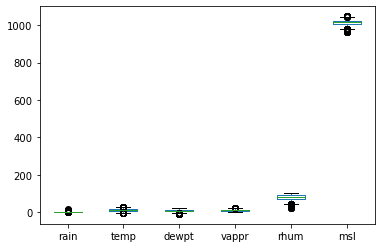

In [16]:
# Plot box plot on hourly weather
hourlyWeather[['rain', 'temp', 'dewpt', 'vappr', 'rhum', 'msl']].plot(kind='box');

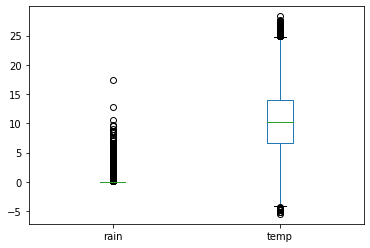

In [17]:
# Box plot on only temperature and weather 
hourlyWeather[['rain', 'temp']].plot(kind='box');#plt.xlim() ylim()

In [18]:
# Histograms on all the hourly weather dataset
hourlyWeather[weatherCols].iplot(kind='hist',
             subplots=True, subplot_titles=True, legend=False,
             bins=15,);

## Pedestrian

### Cleaning Pedestrian Data

In [19]:
# Pedestrian Counts
# 2019 Counts
pedCount2019 = pedCount2019.resample('60min', on='Time').sum()
pedCount2019.reset_index(inplace=True)
pedCount2019.rename(columns={'Time':'date'}, inplace=True)

# 2020 Counts
pedCount2020.rename(columns={'Date & Time':'date'}, inplace=True)

# 2021 Counts
pedCount2021.rename(columns={'Date and Time':'date'}, inplace=True)

# Convert object to datetime
pedCount2019.date = pd.to_datetime(pedCount2019.date)
pedCount2020.date = pd.to_datetime(pedCount2020.date)
pedCount2021.date = pd.to_datetime(pedCount2021.date)

# Merge two datasets into one
pedCount= pd.concat([pedCount2019, pedCount2020])
# Reset index for later merging
pedCount.reset_index(drop=True, inplace=True)

# Sort values to ensure date in time are in order
pedCount.sort_values('date',inplace=True)

# Print to verify Dtypes
pedCount.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17544 entries, 0 to 17543
Data columns (total 26 columns):
 #   Column                                           Non-Null Count  Dtype         
---  ------                                           --------------  -----         
 0   date                                             17544 non-null  datetime64[ns]
 1   O'Connell St Outside Pennys                      17543 non-null  float64       
 2   O'Connell St Outside Clerys                      17543 non-null  float64       
 3   Mary Street                                      12191 non-null  float64       
 4   Capel Street                                     8760 non-null   float64       
 5   Aston Quay                                       17543 non-null  float64       
 6   Grafton Street @ CompuB                          17543 non-null  float64       
 7   Talbot Street North                              17543 non-null  float64       
 8   Doilier Street, Burgh Quay          

In [20]:
# Drop the columns that no longer have counters and Mary Street that has loads of Na's almost all of 2020
pedCount.drop(columns=['Dame Street (Counter Missing)', 
                     'Capel Street - Removed from site 20/10',
                    'Dawson Street'],inplace=True)

# Rename columns to match previous years dataset
pedCount2021.rename(columns={'Date and Time':'date', 
                             "O\'Connell St/Pennys Pedestrian": "O'Connell St Outside Pennys",
                             "O\'Connell st/Princes st North": "O'Connell St Outside Clerys",
                             "Aston Quay/Fitzgeralds": 'Aston Quay',
                             'Grafton Street/CompuB': 'Grafton Street @ CompuB',
                             "Talbot st/Murrays Pharmacy": 'Talbot Street North',
                             "D\'olier st/Burgh Quay": 'Doilier Street, Burgh Quay',
                             "Dawson Street/Molesworth": 'Dawson Street Replacement',
                             "Talbot st/Guineys": 'Talbot Street South',
                             "O\'Connell St/Parnell St/AIB": "O'Connell St, Parnell St @ AIB",
                             "Grafton Street / Nassau Street / Suffolk Street": 'Grafton Street / Nassau Street / Suffolk Street',
                             "College Green/Bank Of Ireland": 'College Green, Bank Of Ireland',
                             "Henry Street/Coles Lane/Dunnes": 'Henry Street',
                             "Westmoreland Street East/Fleet street": 'Westmoreland Street East',
                             "Liffey st/Halfpenny Bridge": 'Liffey Street',
                             "Westmoreland Street West/Carrolls":'Westmoreland Street West',
                             "Grafton st/Monsoon":'Grafton Street', 
                             "Bachelors walk/Bachelors way":'Bachelors Walk',
                             "College Green/Church Lane":'College Green @ Church Lane',
                             "College st/Westmoreland st": 'College Green - Dame St Side',
                             "Capel st/Mary street": 'Capel Street',
                             'Dame Street/Londis': 'Dame Street',
                             'Mary st/Jervis st': 'Mary Street'
                            }, inplace=True)

# Filter out only columns from previous year's dataset
pedCount2021 = pedCount2021[pedCount.columns.values]

# Sort values by date
pedCount2021.sort_values('date',inplace=True)
# Reset index 
pedCount2021.reset_index(drop=True, inplace=True)
pedCount2021

,date,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side
0,2021-01-01 00:00:00,137.00,125.00,NaN,NaN,165.00,111.00,525.00,793.00,45.00,NaN,375.00,85.00,9.00,163.00,227.00,33.00,43.00,220.00,94.00,66.00,52.00,27.00
1,2021-01-01 01:00:00,53.00,51.00,NaN,NaN,25.00,42.00,1204.00,448.00,10.00,NaN,137.00,29.00,2.00,66.00,64.00,22.00,28.00,112.00,26.00,18.00,12.00,18.00
2,2021-01-01 02:00:00,49.00,38.00,NaN,NaN,27.00,25.00,1837.00,262.00,8.00,NaN,210.00,28.00,4.00,40.00,52.00,17.00,32.00,44.00,24.00,11.00,14.00,6.00
3,2021-01-01 03:00:00,30.00,12.00,NaN,NaN,16.00,15.00,2996.00,88.00,6.00,NaN,73.00,24.00,2.00,39.00,14.00,10.00,18.00,15.00,15.00,4.00,7.00,8.00
4,2021-01-01 04:00:00,24.00,12.00,NaN,NaN,16.00,17.00,3621.00,40.00,11.00,NaN,86.00,18.00,0.00,14.00,24.00,2.00,12.00,23.00,0.00,10.00,5.00,6.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,2021-12-31 19:00:00,NaN,807.00,435.00,2301.00,NaN,832.00,0.00,736.00,145.00,1170.00,1347.00,600.00,139.00,1282.00,1123.00,153.00,NaN,1403.00,2394.00,893.00,504.00,239.00
8756,2021-12-31 20:00:00,NaN,884.00,257.00,1695.00,NaN,740.00,0.00,784.00,184.00,1064.00,1468.00,503.00,144.00,1611.00,925.00,213.00,NaN,1353.00,1898.00,964.00,628.00,287.00
8757,2021-12-31 21:00:00,NaN,513.00,108.00,1666.00,NaN,413.00,0.00,499.00,75.00,863.00,1330.00,269.00,87.00,1253.00,524.00,132.00,NaN,716.00,1491.00,945.00,319.00,168.00
8758,2021-12-31 22:00:00,NaN,385.00,109.00,1279.00,NaN,344.00,0.00,357.00,43.00,668.00,1522.00,181.00,53.00,841.00,1401.00,86.00,NaN,543.00,1428.00,690.00,225.00,106.00


### Descriptive Statistics

In [21]:
# Descriptive function for descriptive statistics on pedestrian count dataset for 2019 & 2020
descriptive().allDescriptive(pedCount, title='2019 & 2020 Pedestrian Count')

Percentiles in the 2019 & 2020 Pedestrian Count dataset:
       O'Connell St Outside Pennys  O'Connell St Outside Clerys  Mary Street  \
count                     17543.00                     17543.00     12191.00   
mean                       1040.76                       753.10       205.05   
std                        1051.97                       667.38       241.40   
min                           0.00                         0.00         0.00   
25%                         160.00                       145.00        18.00   
50%                         630.00                       558.00        93.00   
75%                        1720.00                      1292.00       337.50   
90%                        2768.00                      1780.80       582.00   
95%                        3184.00                      2009.00       724.50   
99%                        3715.58                      2303.00       932.10   
max                        4809.00                      3798.00

In [22]:
# Descriptive function for descriptive statistics on pedestrian count dataset for 2021
descriptive().allDescriptive(pedCount2021, title='2021 Pedestrian Count')

Percentiles in the 2021 Pedestrian Count dataset:
       O'Connell St Outside Pennys  O'Connell St Outside Clerys  Mary Street  \
count                      3640.00                      8759.00      4488.00   
mean                        356.44                       508.99       823.64   
std                         354.11                       446.01       922.47   
min                           0.00                         0.00         0.00   
25%                          35.75                        92.50        74.00   
50%                         251.00                       416.00       379.00   
75%                         622.00                       817.00      1480.50   
90%                         840.10                      1183.20      2173.00   
95%                         959.05                      1368.10      2574.65   
99%                        1436.54                      1612.26      3537.39   
max                        2482.00                      2258.00      7

### Descriptive Plots

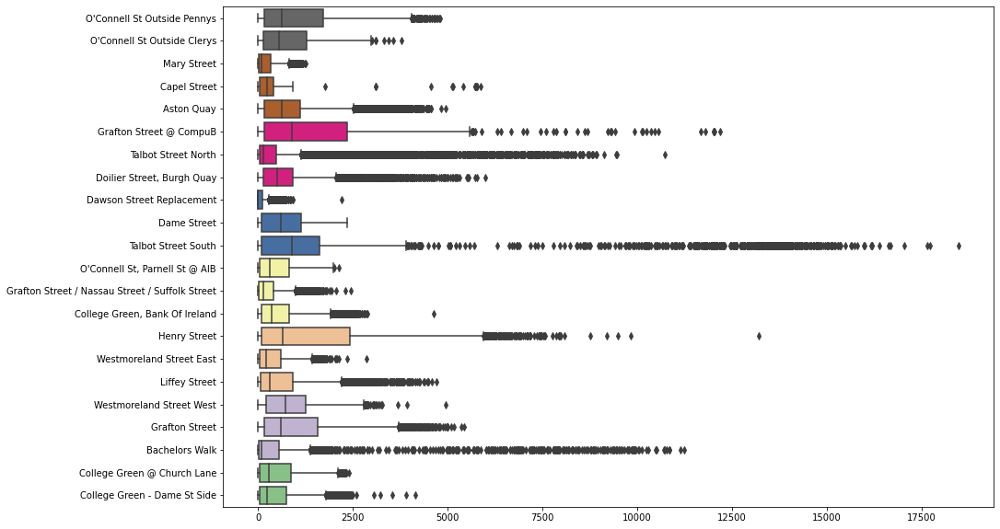

In [23]:
# Box plot for 2019 and 2020 pedestrian and cycle counts dataset
plt.figure(figsize=[15, 10])
sns.boxplot(data=pedCount, orient='h', palette='Accent_r');

In [24]:
# Histogram for pedestrian 2019 and 2020
pedCount[pedCols].iplot(kind='hist',
             subplots=True, subplot_titles=True, legend=False,bestfit=True,
                        vertical_spacing=(1 / (len(pedCount) - 1)),
             bins=15, );

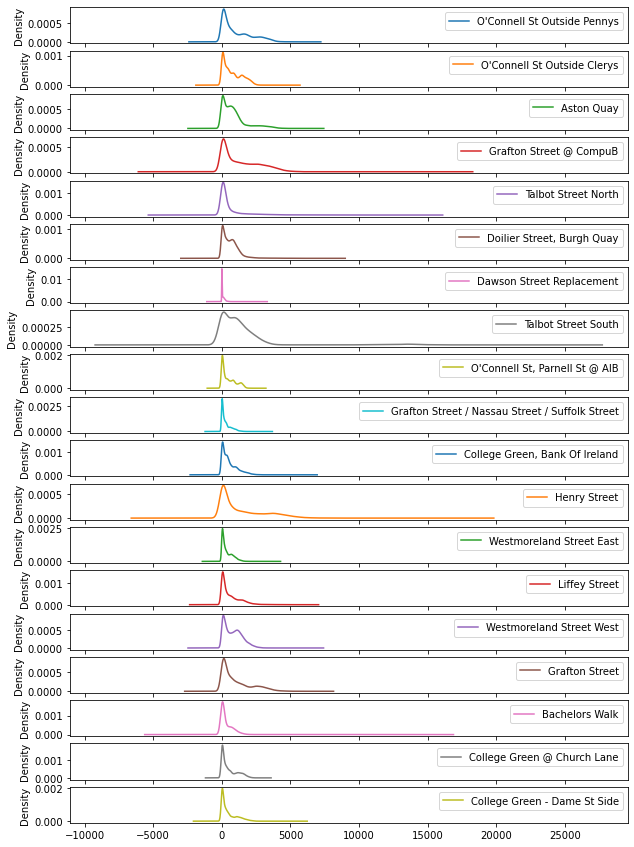

In [25]:
# Histogram for pedestrian 2019 and 2020
pedCount[pedCols].plot(kind='density', subplots=True, figsize=(10,15));

### Pedestrian Hour

In [26]:
# Hourly Exploratory Data Analysis
pedCountEDA = pedCount.copy()
# Create column hour 
pedCountEDA['hour'] = pedCountEDA.date.dt.hour
# Create column day of the week day name for title
pedCountEDA['Day of Week'] = pedCountEDA.date.dt.day_name()
# Get the actual number of day
pedCountEDA['Day'] = pedCountEDA.date.dt.dayofweek
# set the index to day of the week to print in plot
pedCountEDA.set_index('date', inplace=True)
# sort values by day of week
pedCountEDA.sort_values('Day',inplace=True)

# Percentage of counts of total count
(pedCountEDA[pedCols].sum() / sum(pedCountEDA[pedCols].sum()) * 100).sort_values(ascending=False).iplot(kind='bar', colors='blue')

In [27]:
# Plot the individual pedestrian counters and spot there is one line that is not like the others
pedHour = pedCountEDA.groupby(by='hour').mean()
pedHour.drop(columns=['Day'], inplace=True)
pedHour.iplot()

In [28]:
# Can see here that it is Talbot Street South
pedHour[['Doilier Street, Burgh Quay',"O'Connell St Outside Clerys",'Talbot Street South']].iplot();

## Cycle

### Cleaning Cycle Dataset

In [29]:
# convert column name to date
cycleCount2019.rename(columns={'Date and Time':'date'}, inplace=True)
# convert column name to date
cycleCount2020.rename(columns={'Date & Time':'date'}, inplace=True)
# convert column name to date and change street name to match other datasets this column will be deleted
cycleCount2021.rename(columns={'Date & Time':'date',
                              'Drumcondra Cyclists 1' : 'Guild Street'}, inplace=True)

In [30]:
# Convert objects to datetime
cycleCount2019.date = pd.to_datetime(cycleCount2019.date)
cycleCount2020.date = pd.to_datetime(cycleCount2020.date)
cycleCount2021.date = pd.to_datetime(cycleCount2021.date)

# Keep 2019 columns only
cycleCount2020 = cycleCount2020[cycleCount2019.columns]

In [31]:
# Concat dataframes one on top of the other
cycleCount = pd.concat([cycleCount2019, cycleCount2020])

# Reset index
cycleCount.reset_index(drop=True, inplace=True)

# Make sure values are in cronological order
cycleCount.sort_values(by='date', inplace=True)

# Have to drop Guild Street to match 2021 dataset
cycleCount.drop(columns=['Guild Street'])
cycleCount.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17543 entries, 0 to 17542
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   date                 17543 non-null  datetime64[ns]
 1   Grove Road Totem     17526 non-null  float64       
 2   North Strand Rd S/B  17528 non-null  float64       
 3   North Strand Rd N/B  17528 non-null  float64       
 4   Charleville Mall     17528 non-null  float64       
 5   Guild Street         17527 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 959.4 KB


In [32]:
# Keep columns in previous year's dataset
cycleCount2021 = cycleCount2021[cycleCount.columns]
# Sort dataframe by date
cycleCount2021.sort_values('date',inplace=True)
# Reset the index
cycleCount2021.reset_index(drop=True, inplace=True)
# Print the information on the dataframe
cycleCount2021.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   date                 8760 non-null   datetime64[ns]
 1   Grove Road Totem     8759 non-null   float64       
 2   North Strand Rd S/B  8749 non-null   float64       
 3   North Strand Rd N/B  8749 non-null   float64       
 4   Charleville Mall     8754 non-null   float64       
 5   Guild Street         8749 non-null   float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 410.8 KB


### Descriptive Statistics

In [33]:
# Print descriptive stats on cycle counts 2019 & 2020
descriptive().allDescriptive(cycleCount, 'Cycle Statistics for 2019-2020 Datasets')

Percentiles in the Cycle Statistics for 2019-2020 Datasets dataset:
       Grove Road Totem  North Strand Rd S/B  North Strand Rd N/B  \
count          17526.00             17528.00             17528.00   
mean             115.98                42.48                49.56   
std              147.59                67.60                70.97   
min                0.00                 0.00                 0.00   
25%               25.00                 6.00                11.00   
50%               79.00                25.00                29.00   
75%              134.00                50.00                57.00   
90%              265.00                83.00               103.00   
95%              417.00               154.00               174.00   
99%              851.00               408.73               401.00   
max             1152.00               595.00               615.00   

       Charleville Mall  Guild Street  
count          17528.00      17527.00  
mean               6.01

In [34]:
# Print descriptive stats on cycle counts 2021
descriptive().allDescriptive(cycleCount2021, 'Cycle Statistics for 2021 Dataset')

Percentiles in the Cycle Statistics for 2021 Dataset dataset:
       Grove Road Totem  North Strand Rd S/B  North Strand Rd N/B  \
count           8759.00              8749.00              8749.00   
mean              93.24                33.83                40.02   
std               80.63                35.18                42.55   
min                0.00                 0.00                 0.00   
25%               23.00                 6.00                 8.00   
50%               82.00                26.00                28.00   
75%              137.00                50.00                56.00   
90%              202.00                71.00                91.00   
95%              252.00                98.00               130.00   
99%              345.00               167.00               202.52   
max              486.00               319.00               285.00   

       Charleville Mall  Guild Street  
count           8754.00       8749.00  
mean               9.87      

### Decriptive Plots

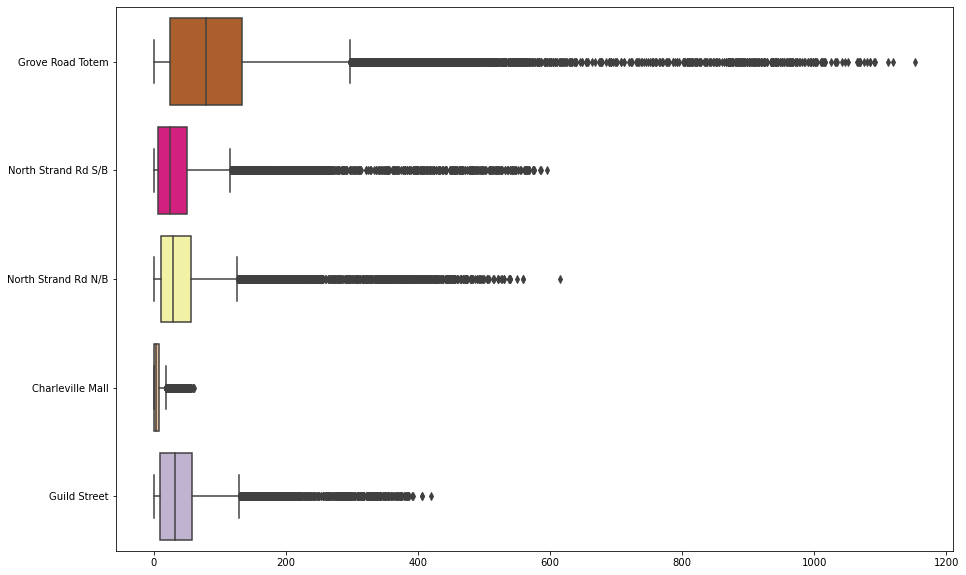

In [35]:
# Box plot for cycle counts 2019 & 2020
plt.figure(figsize=[15, 10])
sns.boxplot(data=cycleCount, orient='h', palette='Accent_r');

In [36]:
# Histogram plots for cycle counts 2019 & 2020
cycleCount[cycleCols].iplot(kind='hist',
             subplots=True, subplot_titles=True, legend=False,
             bins=25,);

### Cycle Hour

In [37]:
# Hourly Exploratory Data Analysis
cycleCountEDA = cycleCount.copy()

# Create column hour with the hour of the day
cycleCountEDA['hour'] = cycleCountEDA.date.dt.hour

# Create column day of the week day name for title
cycleCountEDA['Day of Week'] = cycleCountEDA.date.dt.day_name()

# Get the actual number of day
cycleCountEDA['Day'] = cycleCountEDA.date.dt.dayofweek

# set the index to day of the week to print in plot
cycleCountEDA.set_index('date', inplace=True)

# sort values by day of week
cycleCountEDA.sort_values('Day',inplace=True)

# Percentage of counts of total count
(cycleCountEDA[cycleCols].sum() / sum(cycleCountEDA[cycleCols].sum()) * 100).sort_values(ascending=False).iplot(kind='barh', colors='green');

In [38]:
# Plot the individual cycle counters and two peak times spoted
cycleHour = cycleCountEDA.groupby(by='hour').mean()
cycleHour.drop(columns=['Day'], inplace=True)
cycleHour.iplot()

## Correlations

### Weather

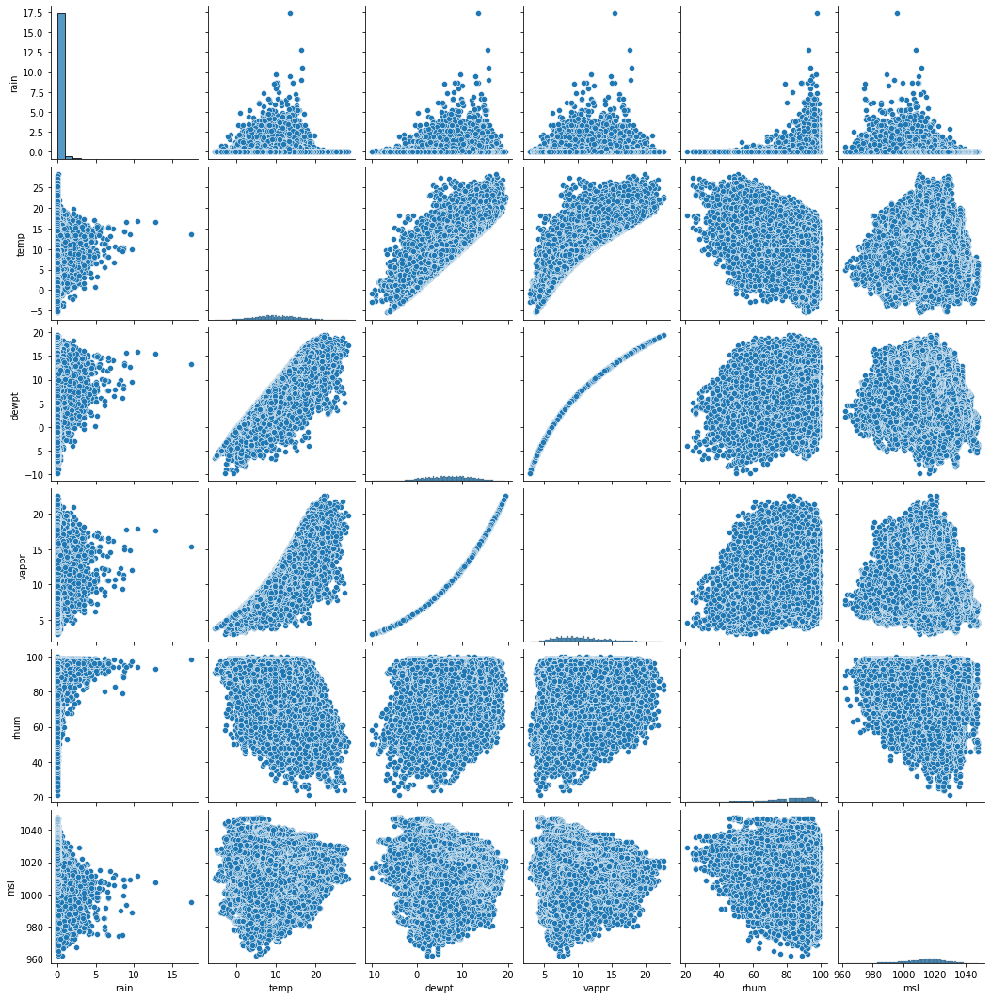

In [39]:
# Plot any correlations in the weather dataset
sns.pairplot(data=hourlyWeather);

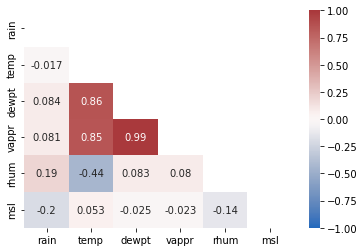

In [40]:
# Only plot the highly correlated data or half the correlation matrix
#https://datagy.io/python-correlation-matrix/
mask = np.triu(np.ones_like(hourlyWeather.corr(), dtype=bool))
sns.heatmap(hourlyWeather.corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

### Pedestrian

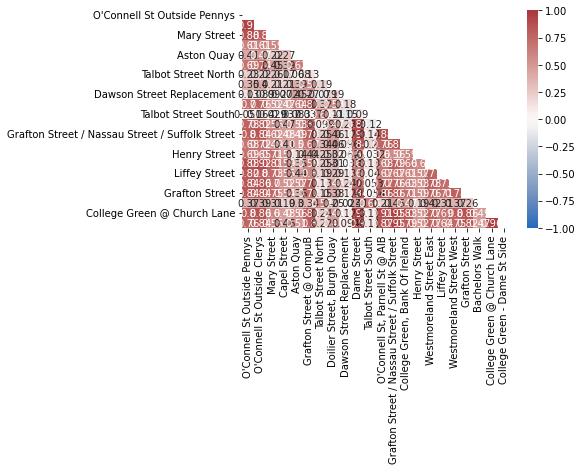

In [41]:
# This plot is useless as there are too many columns.. will redo with totals
#https://datagy.io/python-correlation-matrix/
mask = np.triu(np.ones_like(pedCount.corr(), dtype=bool))
sns.heatmap(pedCount.corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

### Cycle

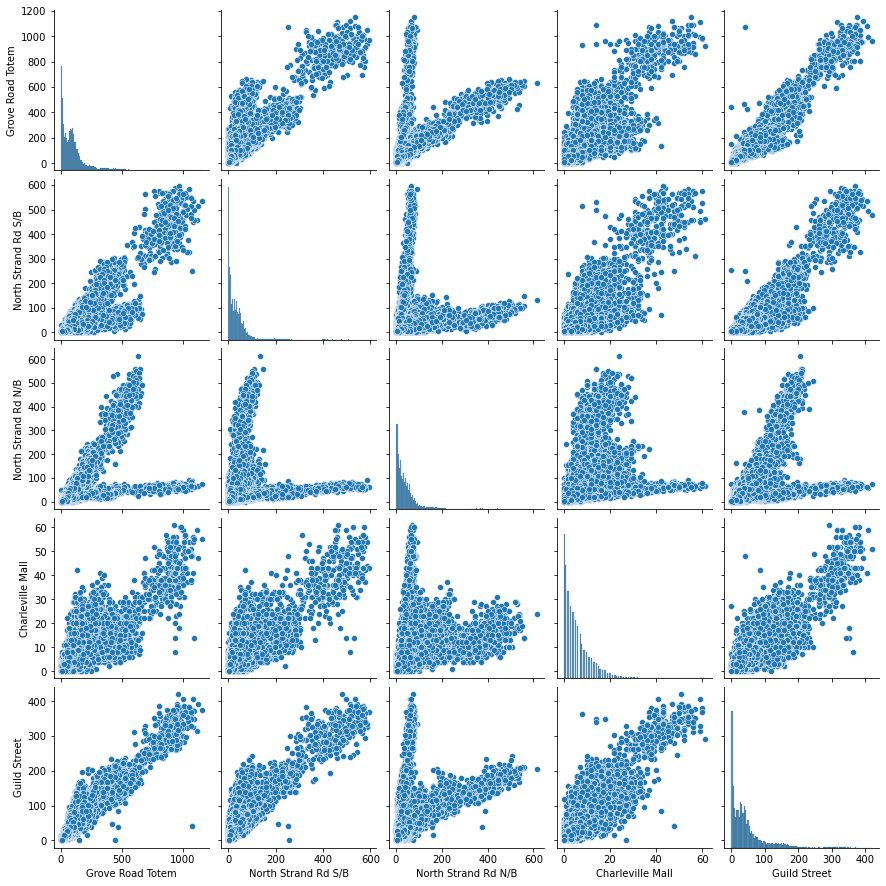

In [42]:
# Plot correlations in cycle counters, not too many counters that I can do this plot
sns.pairplot(data=cycleCount);

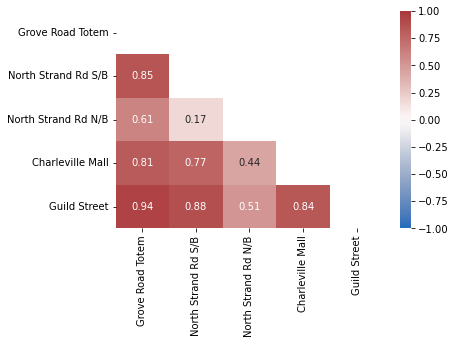

In [43]:
# Only plot the highly correlated data or half the correlation matrix
#https://datagy.io/python-correlation-matrix/
mask = np.triu(np.ones_like(cycleCount.corr(), dtype=bool))
sns.heatmap(cycleCount.corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

# Merge Datasets

In this section the datasets of pedestrian counts, cycle counts, and weather will be merged.  The years 2019 and 2020 will be merged into one dataset to use for both training and testing.  The year 2021 will be for validation of machine learning model.  It is not necessary for the validation but looking to see if the model is generalized enough to perform as well on a dataset that it has never seen. 

In [44]:
# Merge the 2019 & 2020 pedestrian, cycle and weather to prepares for Training and testing dataset
df = pd.merge_asof(pedCount, cycleCount, on='date')
df = pd.merge_asof(df, hourlyWeather, on='date')
df

,date,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl
0,2019-01-01 00:00:00,1504.00,1914.00,163.00,238.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,597.00,1670.00,881.00,1988.00,140.00,0.00,0.00,0.00,12.00,4.00,16.00,1.00,5.00,0.00,9.60,5.60,9.10,76.00,1035.10
1,2019-01-01 01:00:00,1187.00,885.00,102.00,173.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,359.00,767.00,723.00,1270.00,215.00,0.00,0.00,0.00,17.00,8.00,14.00,1.00,6.00,0.00,8.60,5.30,8.90,79.00,1035.10
2,2019-01-01 02:00:00,1233.00,984.00,63.00,121.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,317.00,642.00,1010.00,1589.00,210.00,0.00,0.00,0.00,18.00,9.00,9.00,2.00,2.00,0.00,8.30,5.30,8.90,81.00,1034.90
3,2019-01-01 03:00:00,1316.00,935.00,59.00,174.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,313.00,582.00,772.00,1534.00,204.00,0.00,0.00,0.00,18.00,5.00,15.00,1.00,3.00,0.00,9.10,5.80,9.20,79.00,1035.50
4,2019-01-01 04:00:00,802.00,390.00,46.00,82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,172.00,143.00,197.00,610.00,88.00,0.00,0.00,0.00,12.00,3.00,8.00,1.00,5.00,0.00,9.20,5.90,9.30,79.00,1035.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17539,2020-12-31 19:00:00,284.00,298.00,NaN,NaN,11.00,255.00,700.00,1399.00,121.00,NaN,1757.00,244.00,62.00,234.00,1013.00,70.00,194.00,296.00,136.00,204.00,123.00,97.00,55.00,9.00,5.00,2.00,26.00,0.20,3.90,3.10,7.60,94.00,1009.80
17540,2020-12-31 20:00:00,200.00,207.00,NaN,NaN,30.00,204.00,325.00,1515.00,81.00,NaN,949.00,197.00,29.00,153.00,1377.00,44.00,153.00,274.00,85.00,91.00,64.00,59.00,34.00,2.00,11.00,0.00,13.00,0.60,4.20,3.20,7.70,93.00,1010.60
17541,2020-12-31 21:00:00,155.00,148.00,NaN,NaN,139.00,191.00,533.00,1285.00,129.00,NaN,1303.00,123.00,31.00,164.00,271.00,38.00,86.00,288.00,94.00,85.00,71.00,48.00,22.00,2.00,11.00,3.00,4.00,0.20,4.40,3.40,7.80,93.00,1011.10
17542,2020-12-31 22:00:00,149.00,142.00,NaN,NaN,162.00,179.00,478.00,886.00,120.00,NaN,1024.00,92.00,10.00,139.00,213.00,35.00,66.00,168.00,82.00,44.00,62.00,35.00,24.00,7.00,9.00,3.00,15.00,0.00,4.40,2.90,7.50,89.00,1011.80


In [45]:
# Print descriptive statistics on merged dataset
descriptive().allDescriptive(df, title='All Data')

Percentiles in the All Data dataset:
       O'Connell St Outside Pennys  O'Connell St Outside Clerys  Mary Street  \
count                     17543.00                     17543.00     12191.00   
mean                       1040.76                       753.10       205.05   
std                        1051.97                       667.38       241.40   
min                           0.00                         0.00         0.00   
25%                         160.00                       145.00        18.00   
50%                         630.00                       558.00        93.00   
75%                        1720.00                      1292.00       337.50   
90%                        2768.00                      1780.80       582.00   
95%                        3184.00                      2009.00       724.50   
99%                        3715.58                      2303.00       932.10   
max                        4809.00                      3798.00      1263.00   

  

In [46]:
# Verify the Dtypes are correct
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17544 entries, 0 to 17543
Data columns (total 34 columns):
 #   Column                                           Non-Null Count  Dtype         
---  ------                                           --------------  -----         
 0   date                                             17544 non-null  datetime64[ns]
 1   O'Connell St Outside Pennys                      17543 non-null  float64       
 2   O'Connell St Outside Clerys                      17543 non-null  float64       
 3   Mary Street                                      12191 non-null  float64       
 4   Capel Street                                     8760 non-null   float64       
 5   Aston Quay                                       17543 non-null  float64       
 6   Grafton Street @ CompuB                          17543 non-null  float64       
 7   Talbot Street North                              17543 non-null  float64       
 8   Doilier Street, Burgh Quay          

In [47]:
# Merge the 2021 pedestrian, cycle and weather to prepares for Validation Dataset
df2021 = pd.merge_asof(pedCount2021, cycleCount2021, on='date')
df2021 = pd.merge_asof(df2021, hourlyWeather, on='date')
df2021

,date,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl
0,2021-01-01 00:00:00,137.00,125.00,NaN,NaN,165.00,111.00,525.00,793.00,45.00,NaN,375.00,85.00,9.00,163.00,227.00,33.00,43.00,220.00,94.00,66.00,52.00,27.00,5.00,0.00,2.00,0.00,3.00,0.00,4.70,2.80,7.50,88.00,1012.90
1,2021-01-01 01:00:00,53.00,51.00,NaN,NaN,25.00,42.00,1204.00,448.00,10.00,NaN,137.00,29.00,2.00,66.00,64.00,22.00,28.00,112.00,26.00,18.00,12.00,18.00,4.00,0.00,1.00,0.00,2.00,0.00,4.60,2.70,7.40,87.00,1013.40
2,2021-01-01 02:00:00,49.00,38.00,NaN,NaN,27.00,25.00,1837.00,262.00,8.00,NaN,210.00,28.00,4.00,40.00,52.00,17.00,32.00,44.00,24.00,11.00,14.00,6.00,7.00,0.00,0.00,0.00,1.00,0.00,4.30,2.70,7.40,89.00,1013.80
3,2021-01-01 03:00:00,30.00,12.00,NaN,NaN,16.00,15.00,2996.00,88.00,6.00,NaN,73.00,24.00,2.00,39.00,14.00,10.00,18.00,15.00,15.00,4.00,7.00,8.00,5.00,0.00,0.00,0.00,1.00,0.00,4.10,2.60,7.40,89.00,1014.30
4,2021-01-01 04:00:00,24.00,12.00,NaN,NaN,16.00,17.00,3621.00,40.00,11.00,NaN,86.00,18.00,0.00,14.00,24.00,2.00,12.00,23.00,0.00,10.00,5.00,6.00,6.00,2.00,0.00,3.00,2.00,0.00,3.60,2.10,7.10,89.00,1014.60
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,2021-12-31 19:00:00,NaN,807.00,435.00,2301.00,NaN,832.00,0.00,736.00,145.00,1170.00,1347.00,600.00,139.00,1282.00,1123.00,153.00,NaN,1403.00,2394.00,893.00,504.00,239.00,57.00,14.00,29.00,8.00,0.00,0.00,13.50,9.70,12.00,77.00,1010.40
8756,2021-12-31 20:00:00,NaN,884.00,257.00,1695.00,NaN,740.00,0.00,784.00,184.00,1064.00,1468.00,503.00,144.00,1611.00,925.00,213.00,NaN,1353.00,1898.00,964.00,628.00,287.00,70.00,16.00,26.00,5.00,0.00,0.00,13.30,9.80,12.10,79.00,1010.00
8757,2021-12-31 21:00:00,NaN,513.00,108.00,1666.00,NaN,413.00,0.00,499.00,75.00,863.00,1330.00,269.00,87.00,1253.00,524.00,132.00,NaN,716.00,1491.00,945.00,319.00,168.00,44.00,18.00,21.00,6.00,0.00,0.00,13.20,9.90,12.20,80.00,1009.40
8758,2021-12-31 22:00:00,NaN,385.00,109.00,1279.00,NaN,344.00,0.00,357.00,43.00,668.00,1522.00,181.00,53.00,841.00,1401.00,86.00,NaN,543.00,1428.00,690.00,225.00,106.00,19.00,2.00,11.00,3.00,0.00,0.00,14.40,11.40,13.50,82.00,1009.80


In [48]:
# Print descriptive statistics on merged dataset
descriptive().allDescriptive(df2021, title='2021 All Data')

Percentiles in the 2021 All Data dataset:
       O'Connell St Outside Pennys  O'Connell St Outside Clerys  Mary Street  \
count                      3640.00                      8759.00      4488.00   
mean                        356.44                       508.99       823.64   
std                         354.11                       446.01       922.47   
min                           0.00                         0.00         0.00   
25%                          35.75                        92.50        74.00   
50%                         251.00                       416.00       379.00   
75%                         622.00                       817.00      1480.50   
90%                         840.10                      1183.20      2173.00   
95%                         959.05                      1368.10      2574.65   
99%                        1436.54                      1612.26      3537.39   
max                        2482.00                      2258.00      7303.00  

In [49]:
# Verify the Dtypes are correct
df2021.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8760 entries, 0 to 8759
Data columns (total 34 columns):
 #   Column                                           Non-Null Count  Dtype         
---  ------                                           --------------  -----         
 0   date                                             8760 non-null   datetime64[ns]
 1   O'Connell St Outside Pennys                      3640 non-null   float64       
 2   O'Connell St Outside Clerys                      8759 non-null   float64       
 3   Mary Street                                      4488 non-null   float64       
 4   Capel Street                                     4488 non-null   float64       
 5   Aston Quay                                       2796 non-null   float64       
 6   Grafton Street @ CompuB                          8732 non-null   float64       
 7   Talbot Street North                              8352 non-null   float64       
 8   Doilier Street, Burgh Quay            

# Feature Engineering

In this section features will be created from the existing dataset to help the machine find possible correlations or improve using coefficients. The features that will be added are the day of the week, hour of the day, seasons, and moving average.  The pedestrian total count will be added but this will be the label.

## Add Day of Week and Hour of Day

In [50]:
# Add day of the week name that will later be one hot encoded on both datasets
df['Day of Week'] = df.date.dt.dayofweek
df2021['Day of Week'] = df2021.date.dt.dayofweek

# Add hour of the day that will later be one hot encoded on both datasets
df['Hour'] = df.date.dt.hour
df2021['Hour'] = df2021.date.dt.hour

## Add Seasons

In [51]:
# Add seasons by number and later will change them to strings and then one hot encode
df['Season'] = (df.date.dt.month%12 // 3  + 1)
df2021['Season'] = (df2021.date.dt.month%12 // 3  + 1)
df

,date,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl,Day of Week,Hour,Season
0,2019-01-01 00:00:00,1504.00,1914.00,163.00,238.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,597.00,1670.00,881.00,1988.00,140.00,0.00,0.00,0.00,12.00,4.00,16.00,1.00,5.00,0.00,9.60,5.60,9.10,76.00,1035.10,1,0,1
1,2019-01-01 01:00:00,1187.00,885.00,102.00,173.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,359.00,767.00,723.00,1270.00,215.00,0.00,0.00,0.00,17.00,8.00,14.00,1.00,6.00,0.00,8.60,5.30,8.90,79.00,1035.10,1,1,1
2,2019-01-01 02:00:00,1233.00,984.00,63.00,121.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,317.00,642.00,1010.00,1589.00,210.00,0.00,0.00,0.00,18.00,9.00,9.00,2.00,2.00,0.00,8.30,5.30,8.90,81.00,1034.90,1,2,1
3,2019-01-01 03:00:00,1316.00,935.00,59.00,174.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,313.00,582.00,772.00,1534.00,204.00,0.00,0.00,0.00,18.00,5.00,15.00,1.00,3.00,0.00,9.10,5.80,9.20,79.00,1035.50,1,3,1
4,2019-01-01 04:00:00,802.00,390.00,46.00,82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,172.00,143.00,197.00,610.00,88.00,0.00,0.00,0.00,12.00,3.00,8.00,1.00,5.00,0.00,9.20,5.90,9.30,79.00,1035.70,1,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17539,2020-12-31 19:00:00,284.00,298.00,NaN,NaN,11.00,255.00,700.00,1399.00,121.00,NaN,1757.00,244.00,62.00,234.00,1013.00,70.00,194.00,296.00,136.00,204.00,123.00,97.00,55.00,9.00,5.00,2.00,26.00,0.20,3.90,3.10,7.60,94.00,1009.80,3,19,1
17540,2020-12-31 20:00:00,200.00,207.00,NaN,NaN,30.00,204.00,325.00,1515.00,81.00,NaN,949.00,197.00,29.00,153.00,1377.00,44.00,153.00,274.00,85.00,91.00,64.00,59.00,34.00,2.00,11.00,0.00,13.00,0.60,4.20,3.20,7.70,93.00,1010.60,3,20,1
17541,2020-12-31 21:00:00,155.00,148.00,NaN,NaN,139.00,191.00,533.00,1285.00,129.00,NaN,1303.00,123.00,31.00,164.00,271.00,38.00,86.00,288.00,94.00,85.00,71.00,48.00,22.00,2.00,11.00,3.00,4.00,0.20,4.40,3.40,7.80,93.00,1011.10,3,21,1
17542,2020-12-31 22:00:00,149.00,142.00,NaN,NaN,162.00,179.00,478.00,886.00,120.00,NaN,1024.00,92.00,10.00,139.00,213.00,35.00,66.00,168.00,82.00,44.00,62.00,35.00,24.00,7.00,9.00,3.00,15.00,0.00,4.40,2.90,7.50,89.00,1011.80,3,22,1


## Total Counts

In [52]:
# Sum the cycle counts into new column totals
df['Cycle Total'] = df[['North Strand Rd S/B','North Strand Rd N/B', 'Charleville Mall',
        'Guild Street']].sum(axis=1)
df2021['Cycle Total'] = df2021[['North Strand Rd S/B','North Strand Rd N/B', 'Charleville Mall',
        'Guild Street']].sum(axis=1)

# Sum the pedestrian totals into a newe column that will later be used as label
df['Pedestrian Total'] = df[["O'Connell St Outside Pennys",
       "O'Connell St Outside Clerys",'Talbot Street North', 
        'Talbot Street South',"O'Connell St, Parnell St @ AIB", 
        'Henry Street', 'Liffey Street','Bachelors Walk']].sum(axis=1)
df2021['Pedestrian Total'] = df2021[["O'Connell St Outside Pennys",
       "O'Connell St Outside Clerys",'Talbot Street North', 
        'Talbot Street South',"O'Connell St, Parnell St @ AIB", 
        'Henry Street', 'Liffey Street','Bachelors Walk']].sum(axis=1)

# Reset the index
df.set_index('date', inplace=True)
df2021.set_index('date', inplace=True)

## Add Moving Average

In [53]:
# Peak and non peak seem to happen in 4 hour intervals going to add 4 hour moving average to dataset
rollHours = 4
# Create new column of both cycle count and pedestrian moving average
df[str(rollHours) + ' Hour Cycle Moving Average'] = df['Cycle Total'].rolling(rollHours).mean()
df[str(rollHours) + ' Hour Pedestrian Moving Average'] = df['Pedestrian Total'].rolling(rollHours).mean()

df2021[str(rollHours) + ' Hour Cycle Moving Average'] = df2021['Cycle Total'].rolling(rollHours).mean()
df2021[str(rollHours) + ' Hour Pedestrian Moving Average'] = df2021['Pedestrian Total'].rolling(rollHours).mean()

# All Data Statistics and 

In this section will print and plot descriptive statistics on the merged datasets.  See how the dataset is looking and verify values are numerical and dates where necessary.  

The descriptive statistics and plots on merged datasets with new features might provide a better insight when compared against each other.  The weather dataset shows the seasons of temperature versus rain which confirms life in Ireland. The main features plotted are rain, temperature, cycle count sum, and pedestrian cycle count sum.  These four could show correlations compared to each other along with plot distributions.   

## Descriptive Statistics

In [54]:
# Print descriptive statistics on 2019 and 2020 datasets
descriptive().allDescriptive(df, title='2019 & 2020 Dataset With New Features')

Percentiles in the 2019 & 2020 Dataset With New Features dataset:
       O'Connell St Outside Pennys  O'Connell St Outside Clerys  Mary Street  \
count                     17543.00                     17543.00     12191.00   
mean                       1040.76                       753.10       205.05   
std                        1051.97                       667.38       241.40   
min                           0.00                         0.00         0.00   
25%                         160.00                       145.00        18.00   
50%                         630.00                       558.00        93.00   
75%                        1720.00                      1292.00       337.50   
90%                        2768.00                      1780.80       582.00   
95%                        3184.00                      2009.00       724.50   
99%                        3715.58                      2303.00       932.10   
max                        4809.00                    

In [55]:
# Print descriptive statistics on 2019 and 2020 datasets
descriptive().allDescriptive(df['Pedestrian Total'], title='2019 & 2020 Pedestrian Count')

Percentiles in the 2019 & 2020 Pedestrian Count dataset:
count   17544.00
mean     6504.71
std      5811.81
min         0.00
25%      2385.00
50%      4835.50
75%      9365.50
90%     13504.70
95%     16024.55
99%     31257.56
max     45775.00
Name: Pedestrian Total, dtype: float64 

Zero Counts in the 2019 & 2020 Pedestrian Count dataset Percentage:
0.011399908800729594 

NaN values in the 2019 & 2020 Pedestrian Count dataset Percentage: 
0.0


In [56]:
# Print descriptive statistics on 2019 and 2020 datasets
descriptive().allDescriptive(df['Cycle Total'], title='2019 & 2020 Cycle Count')

Percentiles in the 2019 & 2020 Cycle Count dataset:
count   17544.00
mean      144.95
std       163.92
min         0.00
25%        34.00
50%       100.00
75%       180.00
90%       338.00
95%       479.00
99%       819.57
max      1081.00
Name: Cycle Total, dtype: float64 

Zero Counts in the 2019 & 2020 Cycle Count dataset Percentage:
0.33059735522115824 

NaN values in the 2019 & 2020 Cycle Count dataset Percentage: 
0.0


In [57]:
# Print descriptive statistics on 2021 Validation dataset
descriptive().allDescriptive(df2021, title='2021 Validation Dataset With New Features')

Percentiles in the 2021 Validation Dataset With New Features dataset:
       O'Connell St Outside Pennys  O'Connell St Outside Clerys  Mary Street  \
count                      3640.00                      8759.00      4488.00   
mean                        356.44                       508.99       823.64   
std                         354.11                       446.01       922.47   
min                           0.00                         0.00         0.00   
25%                          35.75                        92.50        74.00   
50%                         251.00                       416.00       379.00   
75%                         622.00                       817.00      1480.50   
90%                         840.10                      1183.20      2173.00   
95%                         959.05                      1368.10      2574.65   
99%                        1436.54                      1612.26      3537.39   
max                        2482.00                

O'Connell St Outside Pennys                        1.50
O'Connell St Outside Clerys                        0.06
Mary Street                                        0.22
Capel Street                                       0.21
Aston Quay                                        21.50
Grafton Street @ CompuB                            0.41
Talbot Street North                               11.56
Doilier Street, Burgh Quay                         0.01
Dawson Street Replacement                          4.57
Dame Street                                        0.35
Talbot Street South                                0.00
O'Connell St, Parnell St @ AIB                     0.01
Grafton Street / Nassau Street / Suffolk Street    2.89
College Green, Bank Of Ireland                     0.23
Henry Street                                       0.01
Westmoreland Street East                           0.83
Liffey Street                                      0.37
Westmoreland Street West                        

## Descriptive Plots

### Weather in Seasons

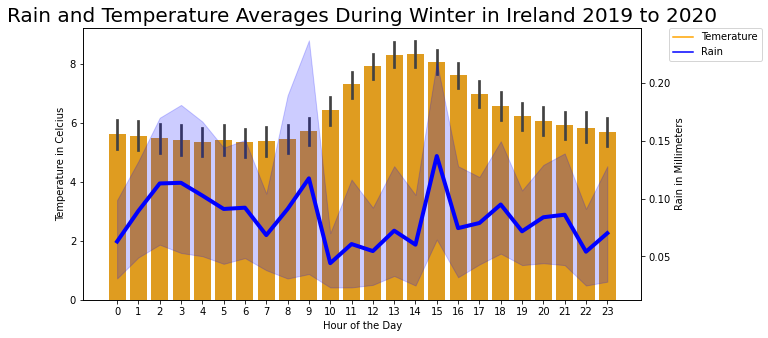

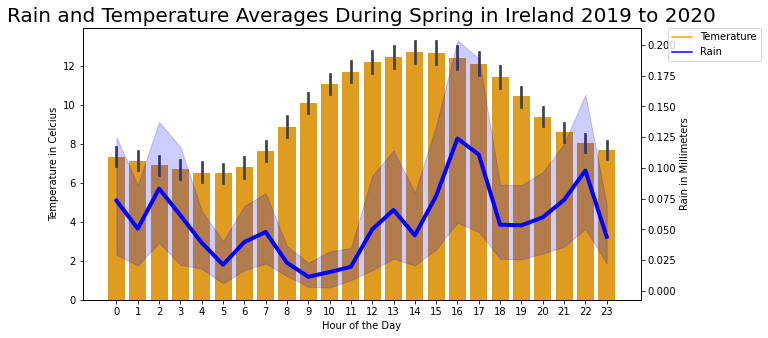

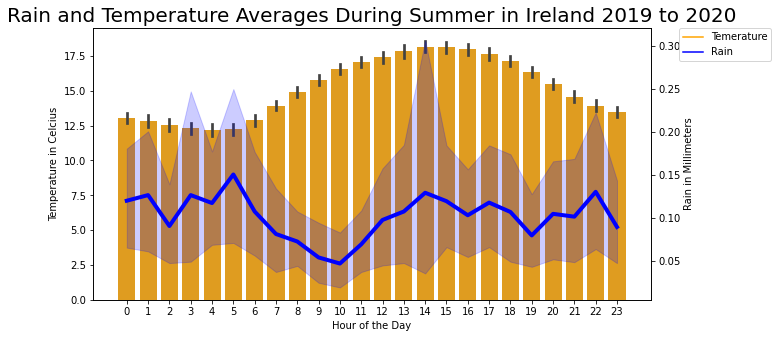

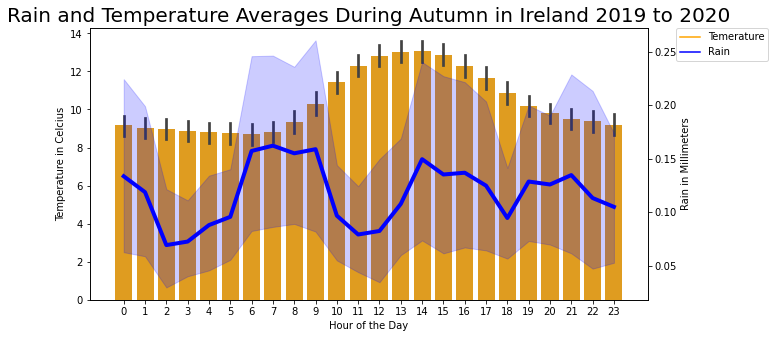

In [58]:
seasons = ['Winter', 'Spring', 'Summer', 'Autumn']
#https://stackoverflow.com/questions/47591650/second-y-axis-time-series-seaborn
from matplotlib.lines import Line2D

for i in range(len(seasons)):
    fig, ax1 = plt.subplots(figsize=(10,5))
    ax1 = sns.barplot(x='Hour', y='temp', 
        data= df[['temp','Hour']][df.Season == i+1], color='orange')
    ax1.set(xlabel='Hour of the Day', ylabel='Temperature in Celcius')
    ax1.grid(False)
    ax2 = ax1.twinx()
    sns.lineplot(x='Hour', y='rain', 
        data=df[['rain','Hour']][df.Season == i+1], ax=ax2,
                linewidth=4, color='blue')
    # https://www.programcreek.com/python/example/96215/seaborn.set
    ax2.set(ylabel='Rain in Millimeters')
    plt.title(label= 'Rain and Temperature Averages During '+ seasons[i] +' in Ireland 2019 to 2020', 
              fontsize=20)
    plt.legend(handles=[Line2D([], [], color="orange", label='Temerature'), 
                        Line2D([], [], color="blue", label='Rain')], fontsize=10,
              bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    
    plt.show();

### Descriptive Plots

In [59]:
# Get the colors in the library to keep them consistent in the plots
cf.colors.cnames

{'aliceblue': '#F0F8FF',
 'antiquewhite': '#FAEBD7',
 'aqua': '#00FFFF',
 'aquamarine': '#7FFFD4',
 'azure': '#F0FFFF',
 'beige': '#F5F5DC',
 'bisque': '#FFE4C4',
 'black': '#000000',
 'blanchedalmond': '#FFEBCD',
 'blue': '#3780bf',
 'bluegray': '#565656',
 'bluepurple': '#6432AB',
 'blueviolet': '#8A2BE2',
 'brick': '#E24A33',
 'brightblue': '#0000FF',
 'brightred': '#FF0000',
 'brown': '#A52A2A',
 'burlywood': '#DEB887',
 'cadetblue': '#5F9EA0',
 'charcoal': '#151516',
 'chartreuse': '#7FFF00',
 'chocolate': '#D2691E',
 'coral': '#FF7F50',
 'cornflowerblue': '#6495ED',
 'cornsilk': '#FFF8DC',
 'crimson': '#DC143C',
 'cyan': '#00FFFF',
 'darkblue': '#00008B',
 'darkcyan': '#008B8B',
 'darkgoldenrod': '#B8860B',
 'darkgray': '#A9A9A9',
 'darkgreen': '#006400',
 'darkgrey': '#A9A9A9',
 'darkkhaki': '#BDB76B',
 'darkmagenta': '#8B008B',
 'darkolivegreen': '#556B2F',
 'darkorange': '#FF8C00',
 'darkorchid': '#9932CC',
 'darkred': '#8B0000',
 'darksalmon': '#E9967A',
 'darkseagreen': '#8F

In [60]:
# Assign colors so that they are consistent
colorPed = '#3780bf'
colorCyc = '#008000'

In [61]:
# histograms of summed 2019 and 2020 data
df[['rain', 'temp','Cycle Total',
       'Pedestrian Total']].iplot(kind='hist',
             subplots=True, subplot_titles=True, legend=False, colors = ['#3780bf','orange', colorCyc, colorPed],
             bins=15,)

<Figure size 1080x720 with 0 Axes>

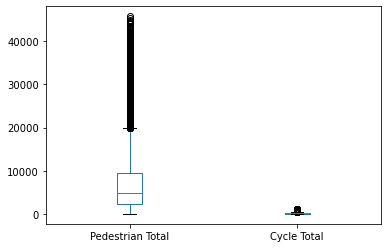

In [62]:
# Box plot of 
plt.figure(figsize=[15, 10])
df[['Pedestrian Total','Cycle Total']].plot(kind='box');

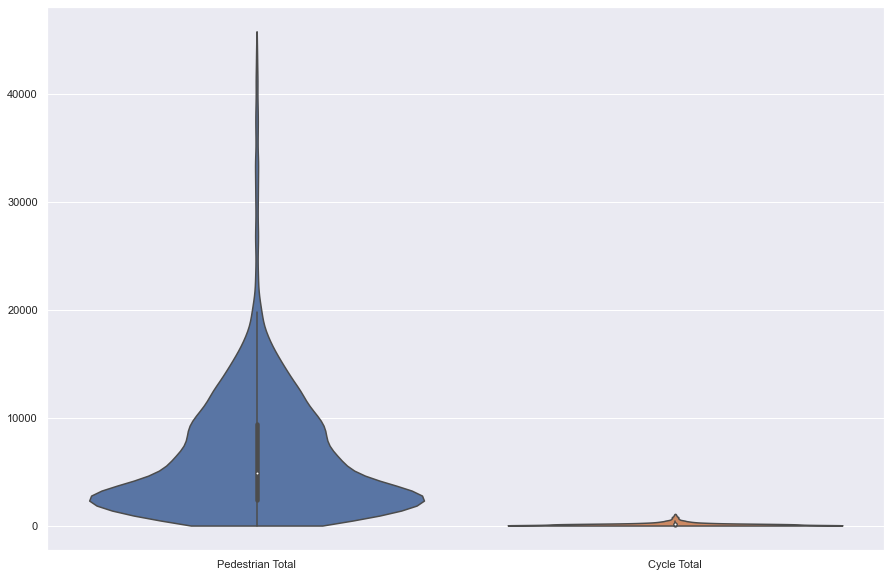

In [63]:
sns.set(rc={'figure.figsize':(15,10)})
sns.violinplot(data=df[['Pedestrian Total','Cycle Total']], scale='width', pallette=[colorPed, colorCyc],
              cut=0);# Cut at my domain no negative count

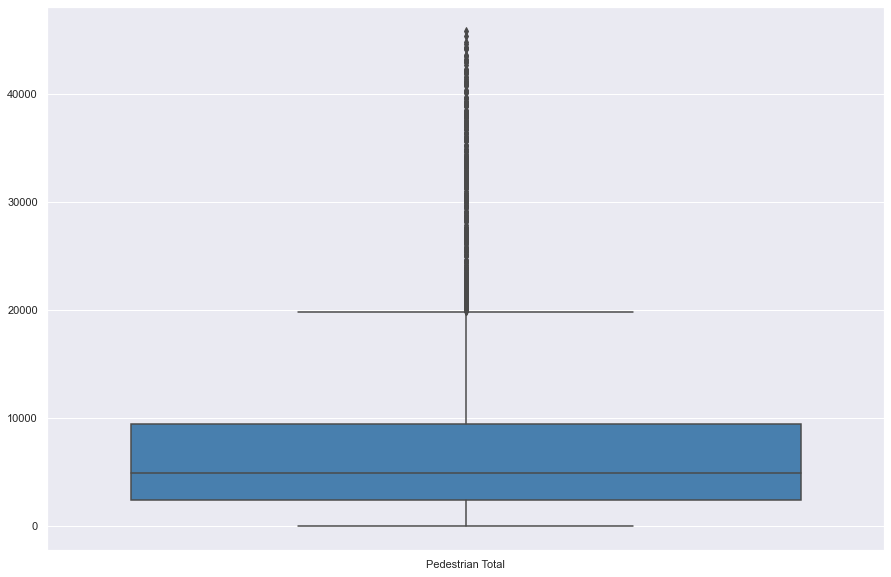

In [64]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=df[['Pedestrian Total']], color=colorPed );

In [65]:
df[['Pedestrian Total']].iplot(kind='histogram', color=colorPed)

In [66]:
q3, q1 = np.percentile(df[['Pedestrian Total']], [75,25])
iqr = q3 - q1
# q3 + (iqr * 1.5) Upper Limit
print('Percentage of pedestrian outliers is {:0.2f} %'.format(len(df['Pedestrian Total'][df['Pedestrian Total'] > (q3 + (iqr*1.5))])/ len(df)*100))

Percentage of pedestrian outliers is 2.26 %


In [67]:
compOutliers = pd.DataFrame()
compOutliers['Pedestrian With Outliers'] = df['Pedestrian Total'].describe().tolist()
compOutliers['Pedestrian Without Outliers'] = df['Pedestrian Total'][df['Pedestrian Total'] <= (q3 + (iqr*1.5))].describe().tolist()
compOutliers['Pedestrian Difference'] = compOutliers['Pedestrian With Outliers'] - compOutliers['Pedestrian Without Outliers']
compOutliers['Pedestrian Percentage'] = (compOutliers['Pedestrian Difference'] / compOutliers['Pedestrian With Outliers']) *100
compOutliers.index = ['count', 'mean', 'std', 'min', '25%','50%','75%','max']
compOutliers

,Pedestrian With Outliers,Pedestrian Without Outliers,Pedestrian Difference,Pedestrian Percentage
count,17544.00,17147.00,397.00,2.26
mean,6504.71,5960.54,544.16,8.37
std,5811.81,4502.45,1309.37,22.53
min,0.00,0.00,0.00,NaN
25%,2385.00,2337.50,47.50,1.99
50%,4835.50,4669.00,166.50,3.44
75%,9365.50,9038.50,327.00,3.49
max,45775.00,19817.00,25958.00,56.71


In [68]:
df[['Pedestrian Total']][df['Pedestrian Total'] <= (q3 + (iqr*1.5))].iplot(kind='histogram', color=colorPed)

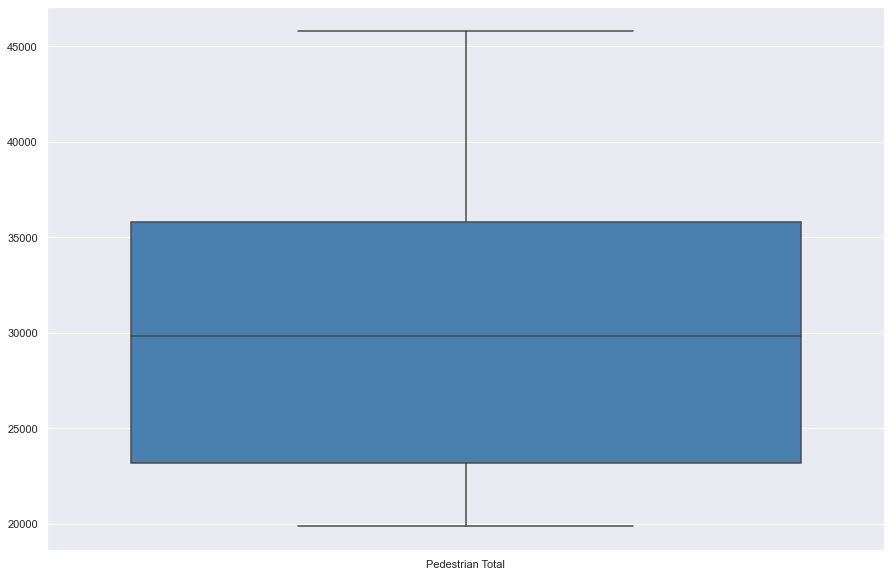

In [69]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=df[['Pedestrian Total']][df['Pedestrian Total'] > (q3 + (iqr*1.5))], color=colorPed);

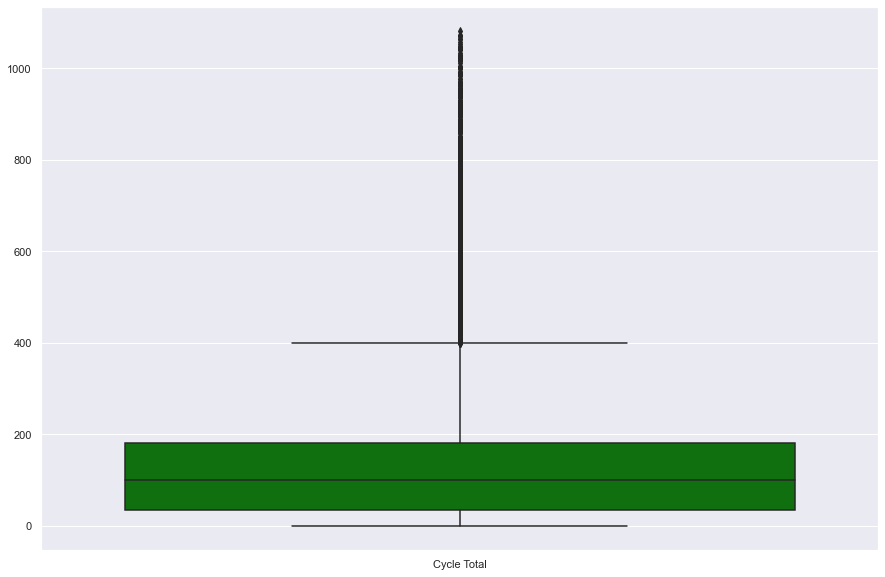

In [70]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=df[['Cycle Total']], color=colorCyc);

In [71]:
df[['Cycle Total']].iplot(kind='histogram', color=colorCyc)

In [72]:
q3, q1 = np.percentile(df[['Cycle Total']], [75,25])
iqr = q3 - q1
print('Percentage of cycle count outliers is {:0.2f} %'.format(len(df['Cycle Total'][df['Cycle Total'] > (q3 + (iqr*1.5))])/ len(df)*100))

Percentage of cycle count outliers is 7.40 %


In [73]:
compOutliers['Cycle With Outliers'] = df['Cycle Total'].describe().tolist()
compOutliers['Cycle Without Outliers'] = df['Cycle Total'][df['Cycle Total'] <= (q3 + (iqr*1.5))].describe().tolist()
compOutliers['Cycle Difference'] = compOutliers['Cycle With Outliers'] - compOutliers['Cycle Without Outliers']
compOutliers['Cycle Percentage'] = (compOutliers['Cycle Difference'] / compOutliers['Cycle With Outliers']) *100
compOutliers

,Pedestrian With Outliers,Pedestrian Without Outliers,Pedestrian Difference,Pedestrian Percentage,Cycle With Outliers,Cycle Without Outliers,Cycle Difference,Cycle Percentage
count,17544.00,17147.00,397.00,2.26,17544.00,16246.00,1298.00,7.40
mean,6504.71,5960.54,544.16,8.37,144.95,108.23,36.72,25.34
std,5811.81,4502.45,1309.37,22.53,163.92,91.89,72.03,43.94
min,0.00,0.00,0.00,NaN,0.00,0.00,0.00,NaN
25%,2385.00,2337.50,47.50,1.99,34.00,30.00,4.00,11.76
50%,4835.50,4669.00,166.50,3.44,100.00,91.00,9.00,9.00
75%,9365.50,9038.50,327.00,3.49,180.00,157.00,23.00,12.78
max,45775.00,19817.00,25958.00,56.71,1081.00,399.00,682.00,63.09


In [74]:
df[['Cycle Total']][df['Cycle Total'] <= (q3 + (iqr*1.5))].iplot(kind='histogram', color=colorCyc)

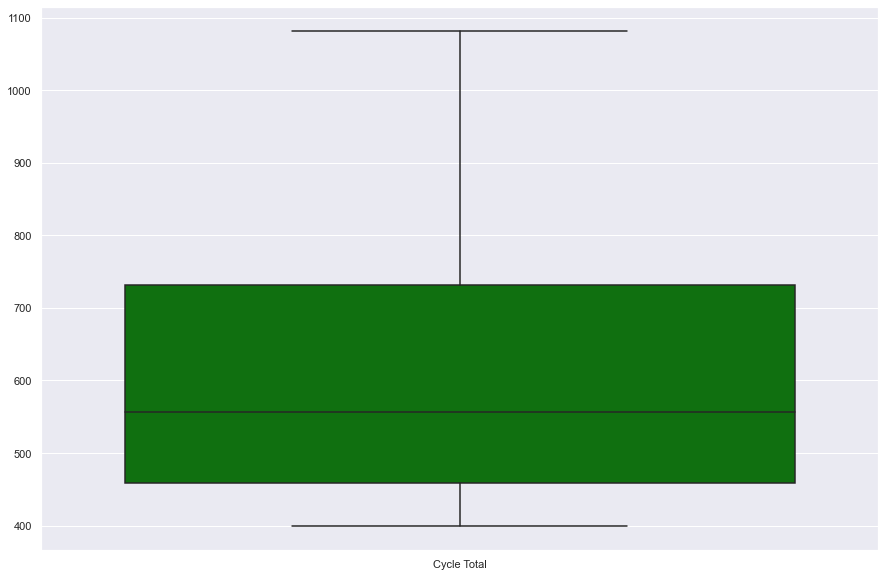

In [75]:
plt.figure(figsize=[15, 10])
sns.boxplot(data=df[['Cycle Total']][df['Cycle Total'] > (q3 +(iqr*1.5))], color=colorCyc);

## Poisson To Probability Normal Distribution

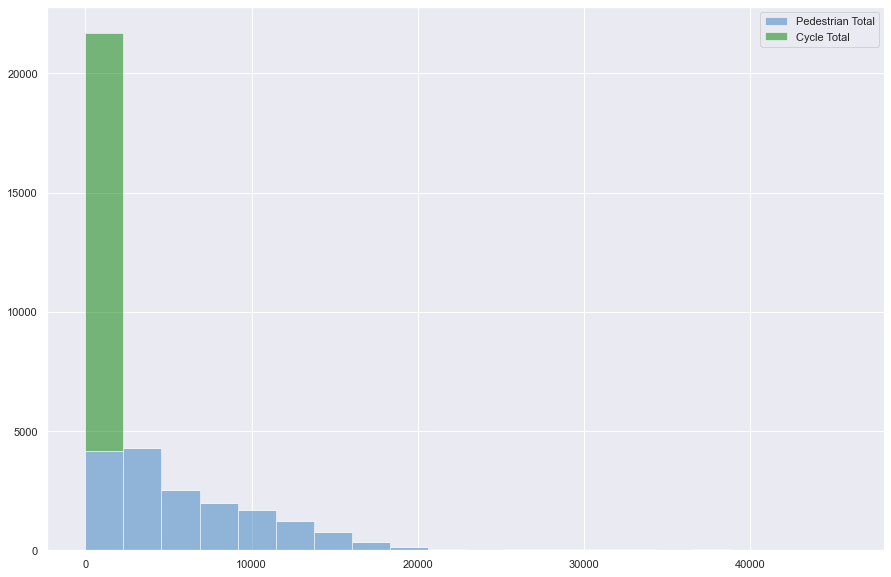

In [76]:
#Poisson distribution printed out
plt.figure(figsize=(15,10))
plt.hist(df[['Pedestrian Total','Cycle Total']], 
         label=['Pedestrian Total', 'Cycle Total'], color=[colorPed,colorCyc], stacked=True, bins=20, alpha=0.5)
plt.legend(loc=0)
plt.show()

### Logrithmic Plot

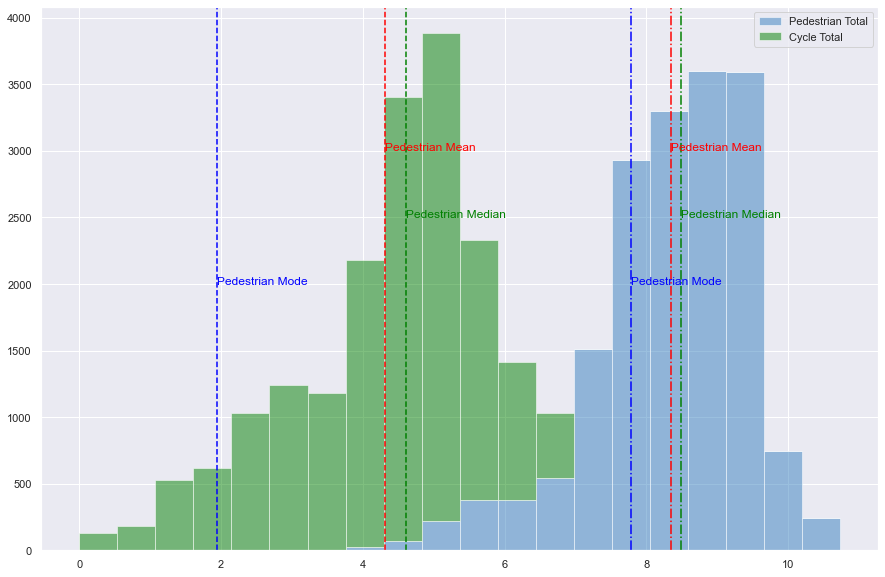

In [77]:
# Using logs to convert into a normal distribution
from statistics import median, mode

plt.figure(figsize=(15,10))
norm = (np.log(df[['Pedestrian Total','Cycle Total']]).replace([np.inf, -np.inf]))

plt.axvline(norm['Pedestrian Total'].mean(), color='red', linestyle='-.')
plt.text(norm['Pedestrian Total'].mean(),3000, 'Pedestrian Mean', color='red')
plt.axvline(median(norm['Pedestrian Total']), color='green', linestyle='-.')
plt.text(median(norm['Pedestrian Total']),2500, 'Pedestrian Median', color='green')
plt.axvline(mode(norm['Pedestrian Total']), color='blue', linestyle='-.')
plt.text(mode(norm['Pedestrian Total']),2000, 'Pedestrian Mode', color='blue')


plt.axvline(norm['Cycle Total'].mean(), color='red', linestyle='--')
plt.text(norm['Cycle Total'].mean(),3000, 'Pedestrian Mean', color='red')
plt.axvline(median(norm['Cycle Total']), color='green', linestyle='--')
plt.text(median(norm['Cycle Total']),2500, 'Pedestrian Median', color='green')
plt.axvline(mode(norm['Cycle Total']), color='blue', linestyle='--')
plt.text(mode(norm['Cycle Total']),2000, 'Pedestrian Mode', color='blue')

plt.hist((np.log(df[['Pedestrian Total','Cycle Total']]).replace([np.inf, -np.inf])), 
         label=['Pedestrian Total', 'Cycle Total'], color=[colorPed,colorCyc], stacked=True, bins=20, alpha=0.5)
plt.legend(loc=0)
plt.show()

### Probability Distribution Pedestrian Total

In [78]:
from scipy.stats import poisson
# https://www.alphacodingskills.com/scipy/scipy-poisson-distribution.php
mu = df['Pedestrian Total'].mean()
x = np.arange(0, int(mu+mu), 1)
y = poisson.pmf(x, mu, 0)

In [79]:
sum(y)

1.0000000000022904

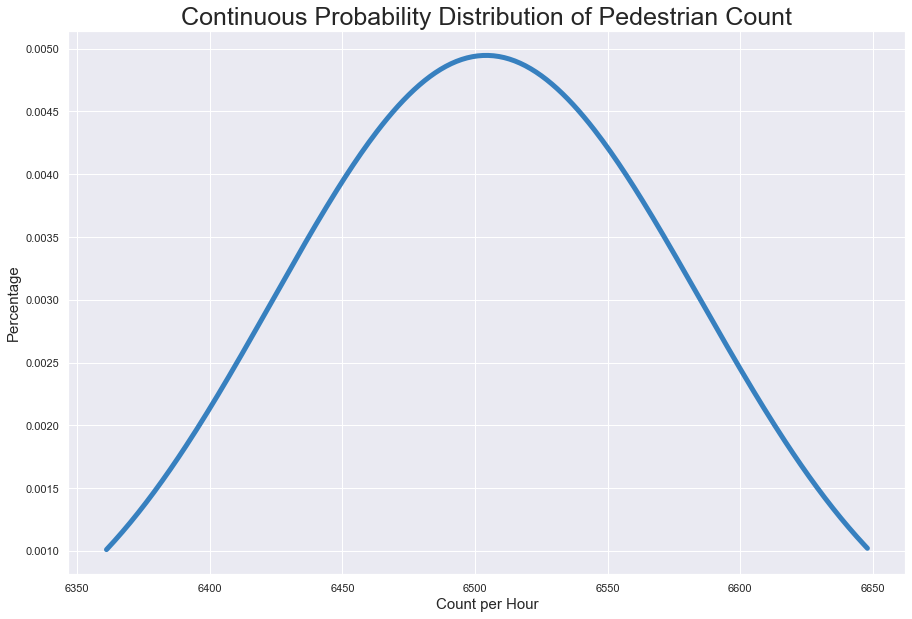

In [80]:
plt.plot(x[y>0.001], y[y>0.001],color=colorPed,lw=5) 
plt.title('Continuous Probability Distribution of Pedestrian Count', fontsize=25)
plt.ylabel('Percentage', fontsize=15)
plt.xlabel('Count per Hour', fontsize=15)
plt.show()

### Probability Distribution Cycle Total

In [81]:
#https://www.alphacodingskills.com/scipy/scipy-poisson-distribution.php
mu = df['Cycle Total'].mean()
x = np.arange(0, int(mu+mu), 1)
y = poisson.pmf(x, mu, 0)

In [82]:
sum(y)

0.9999999999999647

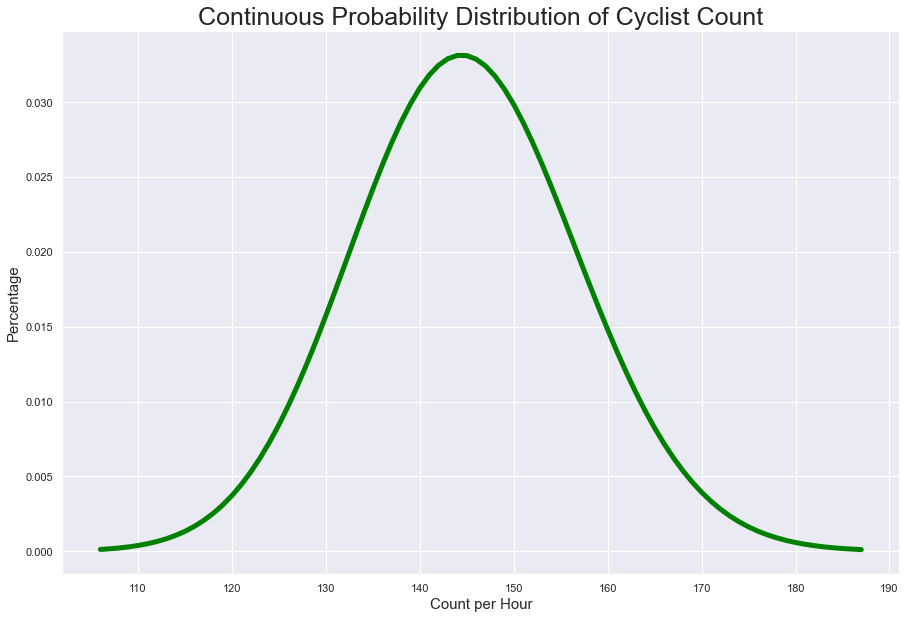

In [83]:
plt.plot(x[y>0.0001], y[y>0.0001],color=colorCyc,lw=5) 
plt.title('Continuous Probability Distribution of Cyclist Count', fontsize=25)
plt.ylabel('Percentage', fontsize=15)
plt.xlabel('Count per Hour', fontsize=15)
plt.show()

## Correlations

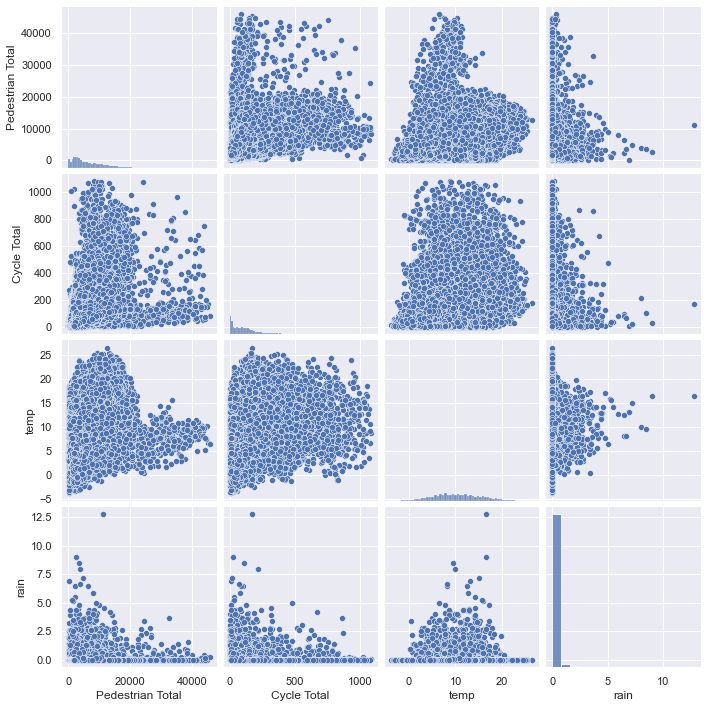

In [84]:
# Correlation of sums
sns.pairplot(data=df[['Pedestrian Total','Cycle Total','temp','rain']]);

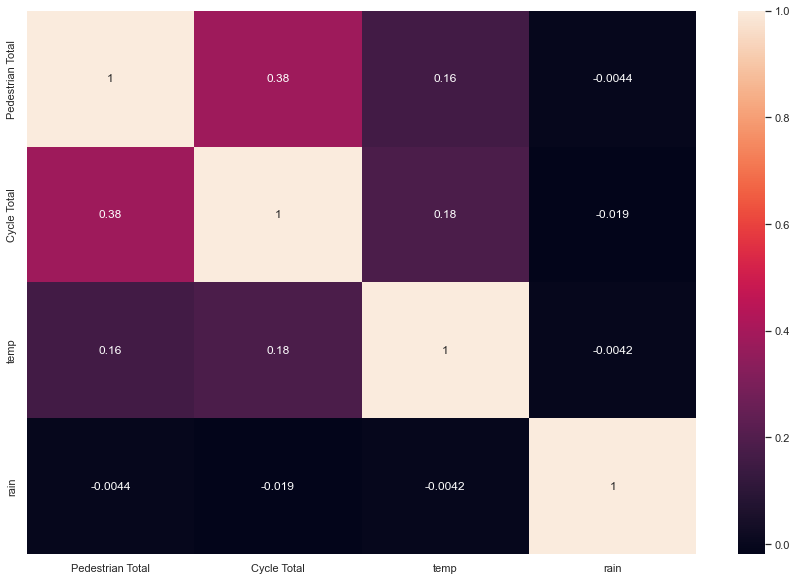

In [85]:
# Correlation of sums in numbers
sns.heatmap(df[['Pedestrian Total','Cycle Total','temp','rain']].corr(), annot=True);

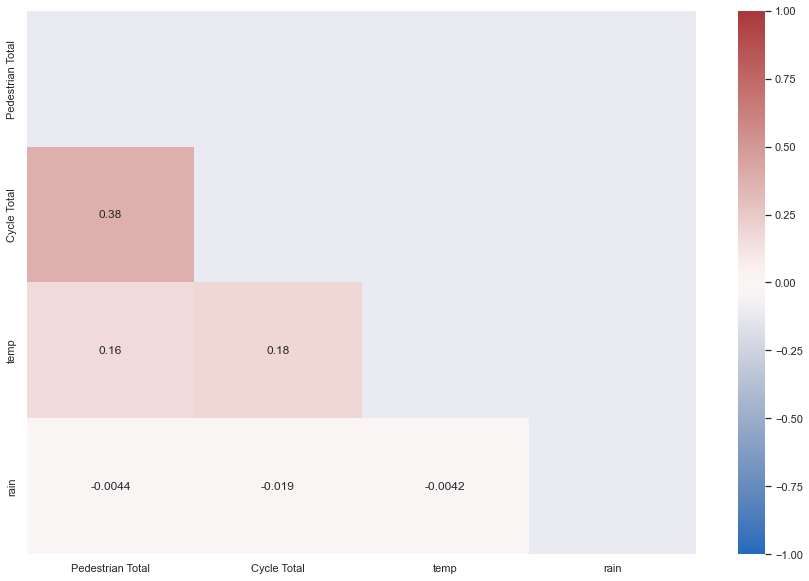

In [86]:
# Correlation of sums in numbers only showing high correlation either positive or negative.
#https://datagy.io/python-correlation-matrix/
mask = np.triu(np.ones_like(df[['Pedestrian Total','Cycle Total','temp','rain']].corr(), dtype=bool))
sns.heatmap(df[['Pedestrian Total','Cycle Total','temp','rain']].corr(), annot=True, vmax=1, vmin=-1, center=0, mask = mask, cmap='vlag')
plt.show();

## Interesting Plot Insights

### Peak versus Non Peak

This line plot has two lines of pedestrian and cycle totals averages plotted by hour.  This clearly shows peak times during the day and justifies using a 4 hour moving average and adding peak and non peak times into the dataset.

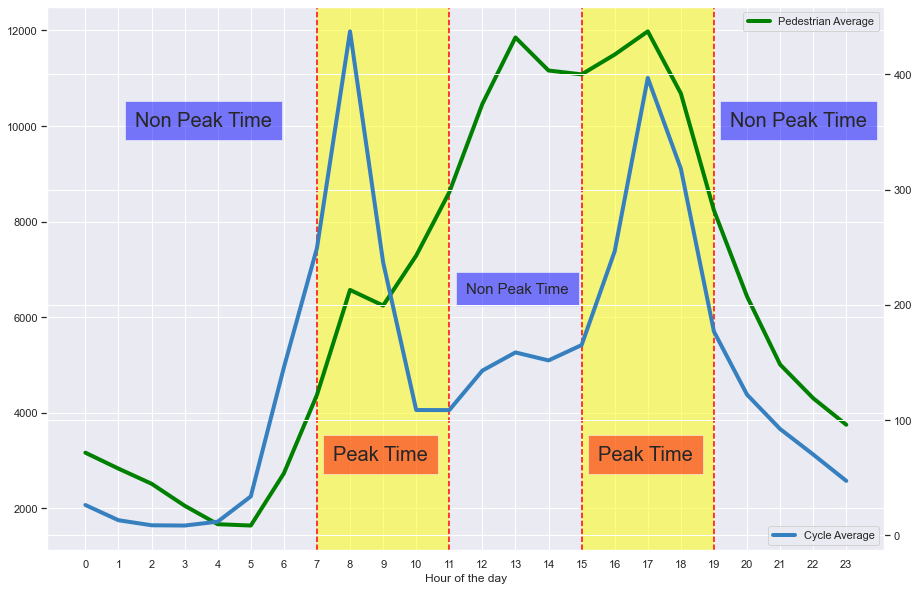

In [87]:
#https://www.statology.org/matplotlib-vertical-line/
# https://stackoverflow.com/questions/3681872/shading-an-area-between-two-points-in-a-matplotlib-plot
#https://matplotlib.org/stable/tutorials/text/text_intro.html

fig, ax1 = plt.subplots(figsize=(15,10))
plt.axvline(x=7, color='red', linestyle='--')
plt.axvline(x=11, color='red', linestyle='--')
plt.axvline(x=15, color='red', linestyle='--')
plt.axvline(x=19, color='red', linestyle='--')
plt.axvspan(7, 11, color='yellow', alpha=0.5, lw=0)
plt.axvspan(15, 19, color='yellow', alpha=0.5, lw=0)
ax1.text(7.5,3000, 'Peak Time', bbox={'facecolor': 'red', 'alpha':0.5, 'pad':10}, fontsize=20)
ax1.text(15.5,3000, 'Peak Time', bbox={'facecolor': 'red', 'alpha':0.5, 'pad':10}, fontsize=20)
ax1.text(1.5,10000, 'Non Peak Time', bbox={'facecolor': 'blue', 'alpha':0.5, 'pad':10}, fontsize=20)
ax1.text(11.5,6500, 'Non Peak Time', bbox={'facecolor': 'blue', 'alpha':0.5, 'pad':10}, fontsize=15)
ax1.text(19.5,10000, 'Non Peak Time', bbox={'facecolor': 'blue', 'alpha':0.5, 'pad':10}, fontsize=20)

# First plot
plt.plot(df[['Pedestrian Total','Hour']].groupby(by='Hour').mean(), label='Pedestrian Average', lw=4.0, color=colorCyc)
plt.xticks(list(df.Hour.unique()))

# Second plot
plt.legend(loc=0)
plt.xlabel('Hour of the day')
ax2 = ax1.twinx()
plt.plot(df[['Cycle Total','Hour']].groupby(by='Hour').mean(), label='Cycle Average', lw=4.0, color=colorPed)
plt.legend(loc=4)
plt.show()

### First 750 Observations

Plotted the first 750 observations of the dataset to see one month of data and find any clear trends in the dataset.  From this I can see that there are peaks by weekday and lower days on the weekends and as above the night hours drop down from peaks.  This plot is not so clear, there is a plot below showing on average a week and hours for both pedestrians and cyclists.  This gives additional evidence as seen above of the cyclical nature of the dataset.

In [88]:
# Subplots of first 750 hours
df[['rain', 'temp','Cycle Total',
       'Pedestrian Total']][:750].iplot(subplots=True,subplot_titles=True,legend=False, colors=['#3780bf','orange', colorCyc, colorPed])

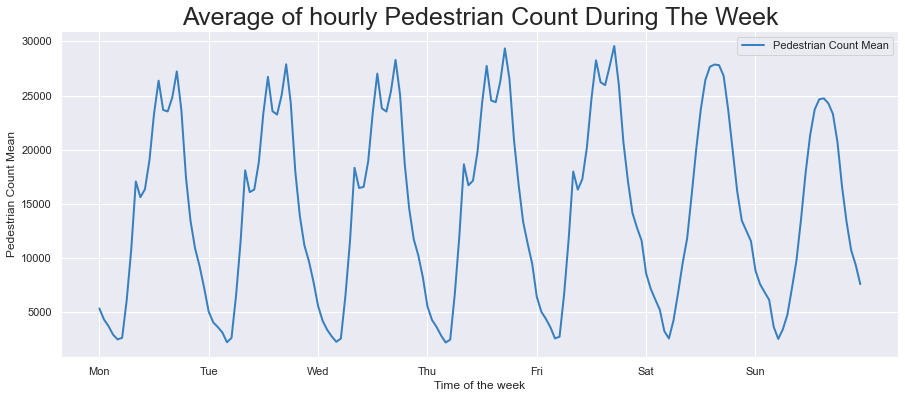

In [89]:
# Average hourly pedestrian count plotted over a week and hours
#https://scikit-learn.org/stable/auto_examples/applications/plot_cyclical_feature_engineering.html
fig, ax = plt.subplots(figsize=(15, 6))

avgWeekPed = pedCountEDA.groupby(['Day', 'hour']).mean()
avgWeekPed.reset_index(inplace=True)
avgWeekPed.drop(columns=['Day','hour'], inplace=True)
avgWeekPed['Total'] = avgWeekPed.sum(axis=1)
avgWeekPed.Total.plot(ax=ax, color=colorPed, label='Pedestrian Count Mean', lw=2)

_ = ax.set(
    xticks=[i * 24 for i in range(7)],
    xticklabels=["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"],
    xlabel="Time of the week",
    ylabel="Pedestrian Count Mean",)
plt.title("Average of hourly Pedestrian Count During The Week", fontsize=25)
plt.legend(bbox_to_anchor=(1.0, 1.0))
plt.show()

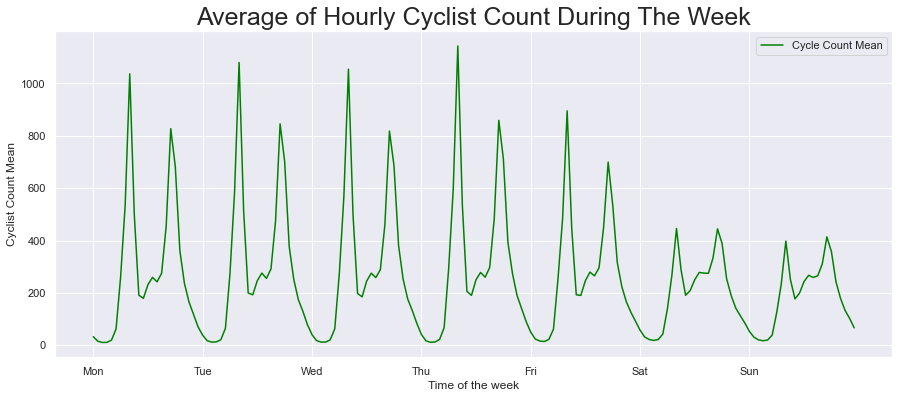

In [90]:
# Average hourly cycle count plotted over a week and hours
#https://scikit-learn.org/stable/auto_examples/applications/plot_cyclical_feature_engineering.html
fig, ax = plt.subplots(figsize=(15, 6))

avgWeekCycle = cycleCountEDA.groupby(['Day', 'hour']).mean()
avgWeekCycle.reset_index(inplace=True)
avgWeekCycle.drop(columns=['Day','hour'], inplace=True)
avgWeekCycle['Total'] = avgWeekCycle.sum(axis=1)
avgWeekCycle.Total.plot(ax=ax, color=colorCyc, label='Cycle Count Mean')

_ = ax.set(
    xticks=[i * 24 for i in range(7)],
    xticklabels=["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"],
    xlabel="Time of the week",
    ylabel="Cyclist Count Mean",)
plt.title("Average of Hourly Cyclist Count During The Week", fontsize=25)
plt.legend(bbox_to_anchor=(1.0, 1.0))
plt.show()

### Noise

This plot looks like there is a lot of noise but what I see is in March of 2019 the almost 400% increase in pedestrian counts.  This is due to Saint Patrick's Day which is not the same in either 2020 or 2021 due to Covid lock down.  Clearly this is an outlier event and removing these outliers should greatly improve models performance. 

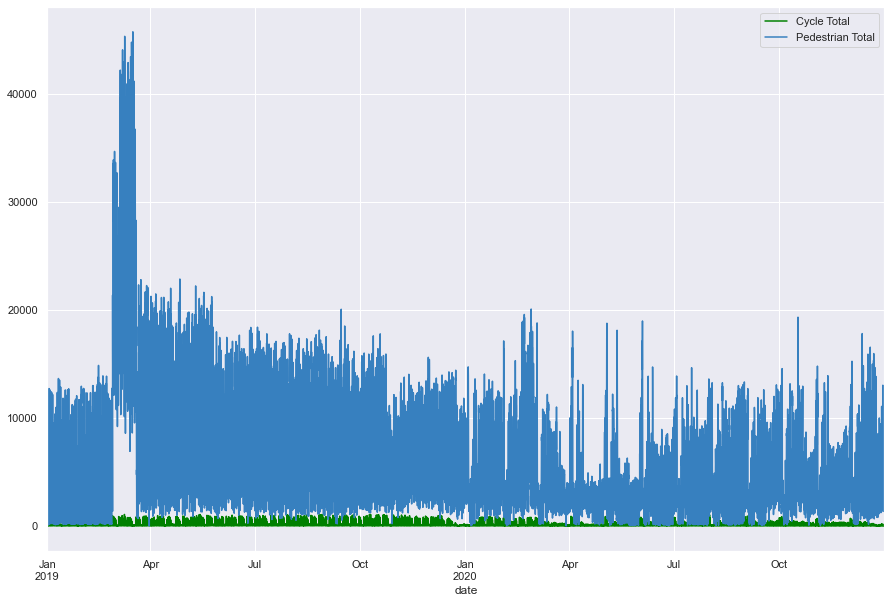

In [91]:
df[['Cycle Total', 'Pedestrian Total']].plot(color=[colorCyc, colorPed]);

# Pre Process Data

In this section the day of week will be converted into weekday and weekend, and this should help the machine distinguish differences in the data.  For hour of the day, it will be converted into peak and non-peak times base on 7 am to 11am and 3pm to 7pm as peak and remainder as non-peak.  Since cycle counts will be used to predict the pedestrian count, those are the peak times for cyclists.  Finally, the season will be put in as winter, spring, summer, and autumn. Keeping it to these smaller categories will help reduce introducing sparsity into the dataset.

Once all the category features have been converted then it is on to one hot encoding those features and replacing them into the dataset. The final part is to drop the pedestrian counter columns to not introduce leakage into the model.

In [92]:
# Week days into two categories of week and weekday
#https://www.geeksforgeeks.org/how-to-replace-values-in-column-based-on-condition-in-pandas/
df['Day of Week'] = np.where(df['Day of Week'] <= 4, 'Week Day', 'Week End')
df2021['Day of Week'] = np.where(df2021['Day of Week'] <= 4, 'Week Day', 'Week End')
df

,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl,Day of Week,Hour,Season,Cycle Total,Pedestrian Total,4 Hour Cycle Moving Average,4 Hour Pedestrian Moving Average
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,1504.00,1914.00,163.00,238.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,597.00,1670.00,881.00,1988.00,140.00,0.00,0.00,0.00,12.00,4.00,16.00,1.00,5.00,0.00,9.60,5.60,9.10,76.00,1035.10,Week Day,0,1,26.00,4896.00,NaN,NaN
2019-01-01 01:00:00,1187.00,885.00,102.00,173.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,359.00,767.00,723.00,1270.00,215.00,0.00,0.00,0.00,17.00,8.00,14.00,1.00,6.00,0.00,8.60,5.30,8.90,79.00,1035.10,Week Day,1,1,29.00,3154.00,NaN,NaN
2019-01-01 02:00:00,1233.00,984.00,63.00,121.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,317.00,642.00,1010.00,1589.00,210.00,0.00,0.00,0.00,18.00,9.00,9.00,2.00,2.00,0.00,8.30,5.30,8.90,81.00,1034.90,Week Day,2,1,22.00,3544.00,NaN,NaN
2019-01-01 03:00:00,1316.00,935.00,59.00,174.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,313.00,582.00,772.00,1534.00,204.00,0.00,0.00,0.00,18.00,5.00,15.00,1.00,3.00,0.00,9.10,5.80,9.20,79.00,1035.50,Week Day,3,1,24.00,3336.00,25.25,3732.50
2019-01-01 04:00:00,802.00,390.00,46.00,82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,172.00,143.00,197.00,610.00,88.00,0.00,0.00,0.00,12.00,3.00,8.00,1.00,5.00,0.00,9.20,5.90,9.30,79.00,1035.70,Week Day,4,1,17.00,1561.00,23.00,2898.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,284.00,298.00,NaN,NaN,11.00,255.00,700.00,1399.00,121.00,NaN,1757.00,244.00,62.00,234.00,1013.00,70.00,194.00,296.00,136.00,204.00,123.00,97.00,55.00,9.00,5.00,2.00,26.00,0.20,3.90,3.10,7.60,94.00,1009.80,Week Day,19,1,42.00,4694.00,62.50,6667.50
2020-12-31 20:00:00,200.00,207.00,NaN,NaN,30.00,204.00,325.00,1515.00,81.00,NaN,949.00,197.00,29.00,153.00,1377.00,44.00,153.00,274.00,85.00,91.00,64.00,59.00,34.00,2.00,11.00,0.00,13.00,0.60,4.20,3.20,7.70,93.00,1010.60,Week Day,20,1,26.00,3499.00,48.00,5281.50
2020-12-31 21:00:00,155.00,148.00,NaN,NaN,139.00,191.00,533.00,1285.00,129.00,NaN,1303.00,123.00,31.00,164.00,271.00,38.00,86.00,288.00,94.00,85.00,71.00,48.00,22.00,2.00,11.00,3.00,4.00,0.20,4.40,3.40,7.80,93.00,1011.10,Week Day,21,1,20.00,2704.00,39.00,4017.50


In [93]:
# Hours to two categories of peak and non peak
df['Hour'] = np.where(((df['Hour'] >= 7) & (df['Hour'] <= 11)) | ((df['Hour'] >= 15) & (df['Hour'] <= 19)), 'Peak Time', 'Non Peak Time')
df2021['Hour'] = np.where(((df2021['Hour'] >= 7) & (df2021['Hour'] <= 11)) | ((df2021['Hour'] >= 15) & (df2021['Hour'] <= 19)), 'Peak Time', 'Non Peak Time')
df

,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl,Day of Week,Hour,Season,Cycle Total,Pedestrian Total,4 Hour Cycle Moving Average,4 Hour Pedestrian Moving Average
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,1504.00,1914.00,163.00,238.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,597.00,1670.00,881.00,1988.00,140.00,0.00,0.00,0.00,12.00,4.00,16.00,1.00,5.00,0.00,9.60,5.60,9.10,76.00,1035.10,Week Day,Non Peak Time,1,26.00,4896.00,NaN,NaN
2019-01-01 01:00:00,1187.00,885.00,102.00,173.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,359.00,767.00,723.00,1270.00,215.00,0.00,0.00,0.00,17.00,8.00,14.00,1.00,6.00,0.00,8.60,5.30,8.90,79.00,1035.10,Week Day,Non Peak Time,1,29.00,3154.00,NaN,NaN
2019-01-01 02:00:00,1233.00,984.00,63.00,121.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,317.00,642.00,1010.00,1589.00,210.00,0.00,0.00,0.00,18.00,9.00,9.00,2.00,2.00,0.00,8.30,5.30,8.90,81.00,1034.90,Week Day,Non Peak Time,1,22.00,3544.00,NaN,NaN
2019-01-01 03:00:00,1316.00,935.00,59.00,174.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,313.00,582.00,772.00,1534.00,204.00,0.00,0.00,0.00,18.00,5.00,15.00,1.00,3.00,0.00,9.10,5.80,9.20,79.00,1035.50,Week Day,Non Peak Time,1,24.00,3336.00,25.25,3732.50
2019-01-01 04:00:00,802.00,390.00,46.00,82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,172.00,143.00,197.00,610.00,88.00,0.00,0.00,0.00,12.00,3.00,8.00,1.00,5.00,0.00,9.20,5.90,9.30,79.00,1035.70,Week Day,Non Peak Time,1,17.00,1561.00,23.00,2898.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,284.00,298.00,NaN,NaN,11.00,255.00,700.00,1399.00,121.00,NaN,1757.00,244.00,62.00,234.00,1013.00,70.00,194.00,296.00,136.00,204.00,123.00,97.00,55.00,9.00,5.00,2.00,26.00,0.20,3.90,3.10,7.60,94.00,1009.80,Week Day,Peak Time,1,42.00,4694.00,62.50,6667.50
2020-12-31 20:00:00,200.00,207.00,NaN,NaN,30.00,204.00,325.00,1515.00,81.00,NaN,949.00,197.00,29.00,153.00,1377.00,44.00,153.00,274.00,85.00,91.00,64.00,59.00,34.00,2.00,11.00,0.00,13.00,0.60,4.20,3.20,7.70,93.00,1010.60,Week Day,Non Peak Time,1,26.00,3499.00,48.00,5281.50
2020-12-31 21:00:00,155.00,148.00,NaN,NaN,139.00,191.00,533.00,1285.00,129.00,NaN,1303.00,123.00,31.00,164.00,271.00,38.00,86.00,288.00,94.00,85.00,71.00,48.00,22.00,2.00,11.00,3.00,4.00,0.20,4.40,3.40,7.80,93.00,1011.10,Week Day,Non Peak Time,1,20.00,2704.00,39.00,4017.50


In [94]:
# Seasons will remain at four categories
df.Season = df.Season.map({1:'Winter',2:'Spring', 3:'Summer', 4:'Autumn'})
df2021.Season = df2021.Season.map({1:'Winter',2:'Spring', 3:'Summer', 4:'Autumn'})
df

,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl,Day of Week,Hour,Season,Cycle Total,Pedestrian Total,4 Hour Cycle Moving Average,4 Hour Pedestrian Moving Average
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,1504.00,1914.00,163.00,238.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,597.00,1670.00,881.00,1988.00,140.00,0.00,0.00,0.00,12.00,4.00,16.00,1.00,5.00,0.00,9.60,5.60,9.10,76.00,1035.10,Week Day,Non Peak Time,Winter,26.00,4896.00,NaN,NaN
2019-01-01 01:00:00,1187.00,885.00,102.00,173.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,359.00,767.00,723.00,1270.00,215.00,0.00,0.00,0.00,17.00,8.00,14.00,1.00,6.00,0.00,8.60,5.30,8.90,79.00,1035.10,Week Day,Non Peak Time,Winter,29.00,3154.00,NaN,NaN
2019-01-01 02:00:00,1233.00,984.00,63.00,121.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,317.00,642.00,1010.00,1589.00,210.00,0.00,0.00,0.00,18.00,9.00,9.00,2.00,2.00,0.00,8.30,5.30,8.90,81.00,1034.90,Week Day,Non Peak Time,Winter,22.00,3544.00,NaN,NaN
2019-01-01 03:00:00,1316.00,935.00,59.00,174.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,313.00,582.00,772.00,1534.00,204.00,0.00,0.00,0.00,18.00,5.00,15.00,1.00,3.00,0.00,9.10,5.80,9.20,79.00,1035.50,Week Day,Non Peak Time,Winter,24.00,3336.00,25.25,3732.50
2019-01-01 04:00:00,802.00,390.00,46.00,82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,172.00,143.00,197.00,610.00,88.00,0.00,0.00,0.00,12.00,3.00,8.00,1.00,5.00,0.00,9.20,5.90,9.30,79.00,1035.70,Week Day,Non Peak Time,Winter,17.00,1561.00,23.00,2898.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,284.00,298.00,NaN,NaN,11.00,255.00,700.00,1399.00,121.00,NaN,1757.00,244.00,62.00,234.00,1013.00,70.00,194.00,296.00,136.00,204.00,123.00,97.00,55.00,9.00,5.00,2.00,26.00,0.20,3.90,3.10,7.60,94.00,1009.80,Week Day,Peak Time,Winter,42.00,4694.00,62.50,6667.50
2020-12-31 20:00:00,200.00,207.00,NaN,NaN,30.00,204.00,325.00,1515.00,81.00,NaN,949.00,197.00,29.00,153.00,1377.00,44.00,153.00,274.00,85.00,91.00,64.00,59.00,34.00,2.00,11.00,0.00,13.00,0.60,4.20,3.20,7.70,93.00,1010.60,Week Day,Non Peak Time,Winter,26.00,3499.00,48.00,5281.50
2020-12-31 21:00:00,155.00,148.00,NaN,NaN,139.00,191.00,533.00,1285.00,129.00,NaN,1303.00,123.00,31.00,164.00,271.00,38.00,86.00,288.00,94.00,85.00,71.00,48.00,22.00,2.00,11.00,3.00,4.00,0.20,4.40,3.40,7.80,93.00,1011.10,Week Day,Non Peak Time,Winter,20.00,2704.00,39.00,4017.50


## One Hot Encoder

In order to possibly help the model improve by coefficients of time the categories will be ones and zeros in new columns created.  Since there is weekday, weekend, peak, non-peak, winter, spring, summer and autumn this will convert three columns into eight giving a one to the column it applies to and zero to the ones that do not.  The model should pick up on these differences and help in the predictive power. 

In [95]:
enc = OneHotEncoder()
encoders = enc.fit_transform(df[['Day of Week', 'Hour', 'Season']]).toarray()
df.drop(columns=['Day of Week', 'Hour', 'Season'], inplace=True)

In [96]:
encoders2 = enc.fit_transform(df2021[['Day of Week', 'Hour', 'Season']]).toarray()
df2021.drop(columns=['Day of Week', 'Hour', 'Season'], inplace=True)

In [97]:
cols = ['Week Day', 'Week End', 'Non Peak', 'Peak', 'Autumn','Spring', 'Summer', 'Winter']
encoded = pd.DataFrame(encoders, columns=cols, index= df.index)
encoded

,Week Day,Week End,Non Peak,Peak,Autumn,Spring,Summer,Winter
date,,,,,,,,
2019-01-01 00:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 01:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 02:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 03:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 04:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00
2020-12-31 20:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2020-12-31 21:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00


In [98]:
encoded2 = pd.DataFrame(encoders2, columns=cols, index= df2021.index)
encoded2

,Week Day,Week End,Non Peak,Peak,Autumn,Spring,Summer,Winter
date,,,,,,,,
2021-01-01 00:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 01:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 02:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 03:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 04:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
...,...,...,...,...,...,...,...,...
2021-12-31 19:00:00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00
2021-12-31 20:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-12-31 21:00:00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00


In [99]:
df = pd.concat([df, encoded], axis=1)
df

,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl,Cycle Total,Pedestrian Total,4 Hour Cycle Moving Average,4 Hour Pedestrian Moving Average,Week Day,Week End,Non Peak,Peak,Autumn,Spring,Summer,Winter
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,1504.00,1914.00,163.00,238.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,597.00,1670.00,881.00,1988.00,140.00,0.00,0.00,0.00,12.00,4.00,16.00,1.00,5.00,0.00,9.60,5.60,9.10,76.00,1035.10,26.00,4896.00,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 01:00:00,1187.00,885.00,102.00,173.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,359.00,767.00,723.00,1270.00,215.00,0.00,0.00,0.00,17.00,8.00,14.00,1.00,6.00,0.00,8.60,5.30,8.90,79.00,1035.10,29.00,3154.00,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 02:00:00,1233.00,984.00,63.00,121.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,317.00,642.00,1010.00,1589.00,210.00,0.00,0.00,0.00,18.00,9.00,9.00,2.00,2.00,0.00,8.30,5.30,8.90,81.00,1034.90,22.00,3544.00,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 03:00:00,1316.00,935.00,59.00,174.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,313.00,582.00,772.00,1534.00,204.00,0.00,0.00,0.00,18.00,5.00,15.00,1.00,3.00,0.00,9.10,5.80,9.20,79.00,1035.50,24.00,3336.00,25.25,3732.50,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2019-01-01 04:00:00,802.00,390.00,46.00,82.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,172.00,143.00,197.00,610.00,88.00,0.00,0.00,0.00,12.00,3.00,8.00,1.00,5.00,0.00,9.20,5.90,9.30,79.00,1035.70,17.00,1561.00,23.00,2898.75,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,284.00,298.00,NaN,NaN,11.00,255.00,700.00,1399.00,121.00,NaN,1757.00,244.00,62.00,234.00,1013.00,70.00,194.00,296.00,136.00,204.00,123.00,97.00,55.00,9.00,5.00,2.00,26.00,0.20,3.90,3.10,7.60,94.00,1009.80,42.00,4694.00,62.50,6667.50,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00
2020-12-31 20:00:00,200.00,207.00,NaN,NaN,30.00,204.00,325.00,1515.00,81.00,NaN,949.00,197.00,29.00,153.00,1377.00,44.00,153.00,274.00,85.00,91.00,64.00,59.00,34.00,2.00,11.00,0.00,13.00,0.60,4.20,3.20,7.70,93.00,1010.60,26.00,3499.00,48.00,5281.50,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2020-12-31 21:00:00,155.00,148.00,NaN,NaN,139.00,191.00,533.00,1285.00,129.00,NaN,1303.00,123.00,31.00,164.00,271.00,38.00,86.00,288.00,94.00,85.00,71.00,48.00,22.00,2.00,11.00,3.00,4.00,0.20,4.40,3.40,7.80,93.00,1011.10,20.00,2704.00,39.00,4017.50,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00


In [100]:
df2021 = pd.concat([df2021, encoded2], axis=1)
df2021

,O'Connell St Outside Pennys,O'Connell St Outside Clerys,Mary Street,Capel Street,Aston Quay,Grafton Street @ CompuB,Talbot Street North,"Doilier Street, Burgh Quay",Dawson Street Replacement,Dame Street,Talbot Street South,"O'Connell St, Parnell St @ AIB",Grafton Street / Nassau Street / Suffolk Street,"College Green, Bank Of Ireland",Henry Street,Westmoreland Street East,Liffey Street,Westmoreland Street West,Grafton Street,Bachelors Walk,College Green @ Church Lane,College Green - Dame St Side,Grove Road Totem,North Strand Rd S/B,North Strand Rd N/B,Charleville Mall,Guild Street,rain,temp,dewpt,vappr,rhum,msl,Cycle Total,Pedestrian Total,4 Hour Cycle Moving Average,4 Hour Pedestrian Moving Average,Week Day,Week End,Non Peak,Peak,Autumn,Spring,Summer,Winter
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01-01 00:00:00,137.00,125.00,NaN,NaN,165.00,111.00,525.00,793.00,45.00,NaN,375.00,85.00,9.00,163.00,227.00,33.00,43.00,220.00,94.00,66.00,52.00,27.00,5.00,0.00,2.00,0.00,3.00,0.00,4.70,2.80,7.50,88.00,1012.90,5.00,1583.00,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 01:00:00,53.00,51.00,NaN,NaN,25.00,42.00,1204.00,448.00,10.00,NaN,137.00,29.00,2.00,66.00,64.00,22.00,28.00,112.00,26.00,18.00,12.00,18.00,4.00,0.00,1.00,0.00,2.00,0.00,4.60,2.70,7.40,87.00,1013.40,3.00,1584.00,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 02:00:00,49.00,38.00,NaN,NaN,27.00,25.00,1837.00,262.00,8.00,NaN,210.00,28.00,4.00,40.00,52.00,17.00,32.00,44.00,24.00,11.00,14.00,6.00,7.00,0.00,0.00,0.00,1.00,0.00,4.30,2.70,7.40,89.00,1013.80,1.00,2257.00,NaN,NaN,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 03:00:00,30.00,12.00,NaN,NaN,16.00,15.00,2996.00,88.00,6.00,NaN,73.00,24.00,2.00,39.00,14.00,10.00,18.00,15.00,15.00,4.00,7.00,8.00,5.00,0.00,0.00,0.00,1.00,0.00,4.10,2.60,7.40,89.00,1014.30,1.00,3171.00,2.50,2148.75,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-01-01 04:00:00,24.00,12.00,NaN,NaN,16.00,17.00,3621.00,40.00,11.00,NaN,86.00,18.00,0.00,14.00,24.00,2.00,12.00,23.00,0.00,10.00,5.00,6.00,6.00,2.00,0.00,3.00,2.00,0.00,3.60,2.10,7.10,89.00,1014.60,7.00,3807.00,3.00,2704.75,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-31 19:00:00,NaN,807.00,435.00,2301.00,NaN,832.00,0.00,736.00,145.00,1170.00,1347.00,600.00,139.00,1282.00,1123.00,153.00,NaN,1403.00,2394.00,893.00,504.00,239.00,57.00,14.00,29.00,8.00,0.00,0.00,13.50,9.70,12.00,77.00,1010.40,51.00,4770.00,65.00,7836.25,1.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00
2021-12-31 20:00:00,NaN,884.00,257.00,1695.00,NaN,740.00,0.00,784.00,184.00,1064.00,1468.00,503.00,144.00,1611.00,925.00,213.00,NaN,1353.00,1898.00,964.00,628.00,287.00,70.00,16.00,26.00,5.00,0.00,0.00,13.30,9.80,12.10,79.00,1010.00,47.00,4744.00,60.75,6315.25,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2021-12-31 21:00:00,NaN,513.00,108.00,1666.00,NaN,413.00,0.00,499.00,75.00,863.00,1330.00,269.00,87.00,1253.00,524.00,132.00,NaN,716.00,1491.00,945.00,319.00,168.00,44.00,18.00,21.00,6.00,0.00,0.00,13.20,9.90,12.20,80.00,1009.40,45.00,3581.00,52.50,5046.25,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00


## Drop UNeccessary Columns

In [101]:
df.drop(columns=["O'Connell St Outside Pennys", "O'Connell St Outside Clerys",'Aston Quay', 
                   'Grafton Street @ CompuB', 'Talbot Street North', 'Doilier Street, Burgh Quay', 
                   'Dawson Street Replacement', 'Talbot Street South', 
                   "O'Connell St, Parnell St @ AIB", 'Grafton Street / Nassau Street / Suffolk Street',
                   'College Green, Bank Of Ireland', 'Henry Street', 'Westmoreland Street East', 
                   'Liffey Street', 'Westmoreland Street West', 'Grafton Street', 'Bachelors Walk',
                   'College Green @ Church Lane', 'College Green - Dame St Side'],
          axis=1, inplace=True)
df2021.drop(columns=["O'Connell St Outside Pennys", "O'Connell St Outside Clerys",'Aston Quay', 
                   'Grafton Street @ CompuB', 'Talbot Street North', 'Doilier Street, Burgh Quay', 
                   'Dawson Street Replacement', 'Talbot Street South', 
                   "O'Connell St, Parnell St @ AIB", 'Grafton Street / Nassau Street / Suffolk Street',
                   'College Green, Bank Of Ireland', 'Henry Street', 'Westmoreland Street East', 
                   'Liffey Street', 'Westmoreland Street West', 'Grafton Street', 'Bachelors Walk',
                   'College Green @ Church Lane', 'College Green - Dame St Side'],
          axis=1, inplace=True)

# Machine Learning

In this section now that EDA has been done, features have been added and categories have been encoded it is almost ready to go to the ML model.  What has not been dealt with is missing data, scaling, and outliers.  The process here is to create a Machine Learning object that will contain all the parameters needed to train and test.  Before that happens, data will be imputed, scaled, and split in a data preparation object class.  There will be pandas and KNN imputer in imputing the dataset and see which performs best.  Then there is scaled and non-scaled data and again see which performs best.  There are three split sizes as this could be a factor in the model's performance.  The three models that will be used is KNN, Randomforest and Ridge.  The ML object will also capture the results, best parameters and in random forest the feature importance.  This will all go into an all-results data frame for later analysis. The one thing the ML object does not do is save the model, this will be done later where the best model parameters will be used on the dataset to again train and test but then plot the visual results. The models are trained and tested with the 2019 and 2020 dataset and the third dataset of 2021 will be used to validate the model if it is general enough using unseen data.  Additionally, there will be training and testing on the dataset with and without outliers to see if performance can be improved.

## Data Prep Class

In [102]:
class dataPrep():
    def __init__(self, data, splitSize, scale, label):
        '''This class creates a data preparation class object to get dataset attributes
        along with methods to transform the dataset.

        Args:
        data (data frame): The dataset containing both features and label.
        splitSize (float): This number is what will be used for train / test split size.
        scale (string): The string will be used to either scale or not scale the dataset.
        label (string): this string will be used to store the label and also to create the y_test and y_train.

        Returns:
        Class object

        Notes: 
        '''
        self.label = label
        self.data = data
        self.splitSize = splitSize
        self.scale = scale
        self.yData = self.data[self.label]
        self.XData = self.data
        
    def imputeData(self, impute):
        '''This method imputes the dataset based on the impute method selected.  There are only two
        ways to impute in this method which are KNN Imputer or Pandas Imputer.

        Args:
        self (class): This class is bringing in all the atributes of the data prep class.
        impute (string): This string will tell what method wthat will be used on the dataset.

        Returns:
        df (data frame): This method returns the feature dataset with all missing values imputed.

        Notes: 
        '''
        # Use KNN imputer
        if impute == 'KNN':
            # Selected 5 neighbors as this is the default setting.
            imputer = KNNImputer(n_neighbors=5)
            impute = imputer.fit_transform(self.data)
            df = pd.DataFrame(impute, columns=self.data.columns)
        # Use pandas imputer
        elif impute == 'Pandas':
            df = self.data.fillna(method='bfill')
            # Had to use ffill where bfill did not have any data at the end of the dataframe.
            if df.isnull().values.any():
                df = df.fillna(method='ffill')
        # Drop the label from the dataset to prevent leakage
        df.drop(columns=self.label,inplace=True)
        # Assign to object imputed data and then return df
        self.data = df
        self.XData = df
        return df
    
    def scaleData(self):
        '''This method scales the dataset using the standard scaler. Other scalers
        in the future could be added to this method.

        Args:
        self (class): This class is bringing in all the atributes of the data prep class.

        Returns:
        scaled (data frame): This method returns the feature dataset scaled.

        Notes: 
        '''
        scaler = StandardScaler()
        scaled = scaler.fit(self.XData)
        data_scaled = scaled.fit_transform(self.XData)
        self.XData = data_scaled
        return scaled
        
    def splitData(self):
        '''This method splits the dataset based on the initial parameters entered of split
        size.  The split will consist of X_train, y_train, X_test and y_test.
        
        Args:
        self (class): This class is bringing in all the atributes of the data prep class.

        Returns:
        X_train (array): This method returns the feature train dataset.
        y_train (array): This method returns the label train dataset.
        X_test (array): This method returns the feature test dataset.
        y_test (array): This method returns the label test dataset.

        Notes: 
        '''
        X_train, X_test, y_train, y_test = train_test_split(self.XData, self.yData, test_size= self.splitSize, shuffle=False)
        return X_train, X_test, y_train, y_test

## Machine Learning Model Class

In [103]:
class mLModel():
    def __init__(self, params, cv, model, data, splitSize, 
                 inputScaler, label, imputer):
        '''This class creates machine learning class object to transform data calling
        the dataprep class and then creating, fitting, collecting metrics and plotting some
        data.  This encompasses what is needed to train, test, and show the models results for analysis. 

        Args:
        params (dictionary): This dictionary will contain parameters available for the machine learning model.
        cv (int): This number is what will be used for cross validation size.
        model (string): This string will be used as a condition to select model.
        data (data frame): The dataset containing both features and label.
        splitSize (float): This number is what will be used for train / test split size.
        inputScaler (string): The string will be used to either scale or not scale the dataset.
        label (string): this string will be used to store the label.
        imputer (string): this string will be used to choose which imputer to use.

        Returns:
        Class object

        Notes: 
        '''
        self.params = params
        self.cv = cv
        self.imputer = imputer
        self.model = model
        self.data = data
        self.splitSize = splitSize
        self.scale = inputScaler
        self.label = label
        self.fittedModel = None
        self.bestParams = None
        
    def transformData(self):
        '''This method starts the process of transforming the dataset first by 
        imputing, then scaling and finally splitting the dataset into X_train, 
        y_train, X_test and y_test.
        
        Args:
        self (class): This class is bringing in all the atributes of the MLModel class.

        Returns:
        X_train (array): This method returns the feature train dataset.
        y_train (array): This method returns the label train dataset.
        X_test (array): This method returns the feature test dataset.
        y_test (array): This method returns the label test dataset.

        Notes: 
        '''
        dataT = dataPrep(self.data, self.splitSize, self.scale, self.label)
        data = dataT.imputeData(self.imputer)
        self.data = data
        # Decided to put the scaler into the ML class as I was having issues in the dataprep class.
        if self.scale == 'Standard':
            scaledData = dataT.scaleData()
            X_train, X_test, y_train, y_test = dataT.splitData()
            return X_train, X_test, y_train, y_test
        else:
            X_train, X_test, y_train, y_test = dataT.splitData()
            return X_train, X_test, y_train, y_test
    
    def createModel(self):
        '''This method creates the model with all the parameters passed into the class.
        This will use randomized search to search for the best settings to return 
        best model parameters. The only settings for the randomized search that have been
        put in are double the default number of iterations, verbose set to 2 to print out
        some verbosity, cv default is 5 even though I have made that able to be changed 
        when creating the object.  Number of jobs is set to -1 which means using all the
        processors in the CPU. Returning the train score is set to true in an effort to 
        retrieve the score if needed. 
        
        Args:
        self (class): This class is bringing in all the atributes of the MLModel class.

        Returns:
        model (class object): This method returns a machine learning class object with all
        the settings ready to be fit.

        Notes: 
        '''
        if self.model == 'Ridge':
            model = RandomizedSearchCV(estimator=Ridge(), param_distributions=self.params,
                n_iter = 20, cv = self.cv, verbose=2, n_jobs=-1, return_train_score=True)
        if self.model == 'RandomForest':
            model = RandomizedSearchCV(estimator=RandomForestRegressor(), param_distributions=self.params, 
                            n_iter = 20, cv = self.cv, verbose=2, n_jobs=-1, 
                                return_train_score=True)
        if self.model == 'KNN':
            model = RandomizedSearchCV(estimator=KNeighborsRegressor(), param_distributions=self.params,
                n_iter = 20, cv = self.cv, verbose=2, n_jobs=-1, return_train_score=True)
        return model
    
    def fitModel(self, model, X_train, y_train):
        '''This method fits the model with training datasets.
        
        Args:
        self (class): This class is bringing in all the atributes of the MLModel class.
        model (class object): This class is bringing in all the atributes of a 
        machine learning object with all the settings ready to be fit.
        X_train (array): Feature array.
        y_train (array): Label array.
        
        Returns:
        fitMod (fitted ML Class Object): This method returns a fitted ML Class object
        that can be used to predict on Testing or validaton dataset. 

        Notes: 
        '''
        fitMod = model.fit(X_train, y_train)
        self.bestParams = fitMod.best_params_
        self.fittedModel = fitMod
        self.score = fitMod.best_score_
        return fitMod
    
    def getMetrics(self, X_train, X_test, y_train, y_test, lossFunction):
        '''This method returns metrics from the loss functions on the datasets. 
        This includes training and testing data.
        
        Args:
        self (class): This class is bringing in all the atributes of the MLModel class.
        X_train (array): Feature array.
        y_train (array): Label array.
        X_test (array): Feature array.
        y_test (array): Label array.
        lossFunction (list): a list of loss functions to use as metrics.

        Returns:
        pred_train (array): This method returns the predictions of the model on the training dataset.
        pred_test (array): This method returns the predictions of the model on the test dataset.
        results (dataframe): Returns dataframe with stored metrics and model parameters, including
        best parameters and feature importance(only for random forest).

        Notes: 
        '''
        # create lists to append metrics to.
        r2 = []
        mse = []
        mae = []
        predTrain = self.fittedModel.predict(X_train)
        predTest = self.fittedModel.predict(X_test)
        for loss in lossFunction:
            if loss == mean_squared_error:
                mse.append(mean_squared_error(y_train, predTrain))
                mse.append(mean_squared_error(y_test, predTest))
            elif loss == r2_score:
                r2.append(r2_score(y_train, predTrain))
                r2.append(r2_score(y_test, predTest))
            if loss == mean_absolute_error:
                mae.append(mean_absolute_error(y_train, predTrain))
                mae.append(mean_absolute_error(y_test, predTest))    
        # Create dataframe to store and return from method.
        results = pd.DataFrame()
        results['Data Set'] = ['Train','Test']
        results['Label'] = self.label
        results['Scaled'] = self.scale
        results['Imputer'] = self.imputer
        results['Split'] = self.splitSize
        results['MSE'] = mse
        results['MAE'] = mae
        results['R2'] = r2
        results['Model'] = self.model
        results['Best Params'] = str(self.bestParams)
        results['feature importance'] = 'Not Available'
        # Only return feature imporance for random forest and will return as an object..  
        if self.model == 'RandomForest':
            results.at[0,'feature importance'] = self.fittedModel.best_estimator_.feature_importances_.astype('object')
            results.at[1,'feature importance'] = self.fittedModel.best_estimator_.feature_importances_.astype('object')
        return predTrain, predTest, results
    
    def visualizeResults(self, period, y_test, predTest):
        '''This will plot the results from the predictions to actual label.  The period size
        is to reduce the plot to show a certain time frame like zooming in.
        
        Args:
        self (class): This class is bringing in all the atributes of the MLModel class.
        period (int): how many periods to display from the start of the predictions.
        y_test (array): the label array to compare.
        predTest (array): the predictions the model did.

        Returns:
        plots from the data entered.
        
        Notes: 
        '''
        x_ax = range(len(y_test[:period]))
        plt.scatter(x_ax, y_test[:period], s=5, color="blue", label="original")
        plt.plot(x_ax, predTest[:period], lw=0.8, color="red", label="predicted")
        plt.legend()
        plt.show()

## Loss Functions

In [104]:
# Loss functions used to capture model performance along with r2 score for accuracy.
lossFunction = [mean_squared_error, mean_absolute_error, r2_score] 

# Dataframe to store results
totalResults = pd.DataFrame()

## Model Parameters

In [105]:
# Random Forest Model Parameters
rfParams = {'bootstrap': [True, False], 
          'max_depth': [10, 20, 100], 
          'max_features': ['sqrt', 'log2', 'auto'], 
          'n_estimators': [10, 50, 100, 500, 1000, 2000]}

# Ridge Model Parameters
ridgeParams = {'alpha': [0.001, 0.01, 0.1, 1, 5, 10], 
          'normalize': [True, False]}

# Lasso Model Parameters
knnParams = {'n_neighbors': [5, 10, 15, 20, 30], 
          'leaf_size': [20, 30, 40, 50],
              'p': [1, 2]}

## Create and Fit Models

In [106]:
count = 1
total = len(scalers) * len(imputers) * len(models) * len(splitSizes)
pre = 'Pedestrian Total'
for mod in models:
    for sca in scalers:
        for spl in splitSizes:
            for imp in imputers:
                data = df.copy()
                valData = df2021.copy()
                if mod == 'KNN':
                    p = knnParams
                elif mod == 'Ridge':
                    p = ridgeParams
                elif mod == 'RandomForest':
                    p = rfParams

                # Create machine learning class
                randomSearch = mLModel(params=p, cv=5, model=mod,
                                                   data=data, splitSize=spl, inputScaler=sca, 
                                            label=pre, imputer=imp)
                # Split the dataset
                X_train, X_test, y_train, y_test = randomSearch.transformData()

                # Create the model 
                model = randomSearch.createModel()

                # Fit the model and test 
                randomSearch.fitModel(model, X_train, y_train)

                # Get metrics
                predTrain, predTest, results = randomSearch.getMetrics(X_train, X_test, y_train,
                                                            y_test, lossFunction)
                # Validation data using trained model.
                dataX = dataPrep(valData, spl, sca, pre)
                dataX.imputeData(imp)
                dataX.scaleData()

                pred2021 = randomSearch.fittedModel.predict(dataX.XData)

                y = valData[[pre]]
                results.loc[len(results.index)] = ['Validation Data', pre, sca, imp, spl, 
                                                   mean_squared_error(y, pred2021),
                    mean_absolute_error(y, pred2021),r2_score(y, pred2021), mod, 'NA', 'NA']
                
                # Store results
                totalResults = pd.concat([totalResults, results], axis=0)
                print('Model {}, with {}, {}, and split size {}'.format(mod, imp, sca, spl))
                print('Result for this model is {:2f} % '.format(r2_score(y, pred2021)))
                print('Completed {}%'.format(round((count / total)*100,2)))
                count += 1

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    7.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    9.7s finished


Model KNN, with KNN, Not Scaled, and split size 0.5
Result for this model is -2.052219 % 
Completed 2.78%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    2.6s finished


Model KNN, with Pandas, Not Scaled, and split size 0.5
Result for this model is -2.050722 % 
Completed 5.56%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    4.4s finished


Model KNN, with KNN, Not Scaled, and split size 0.3
Result for this model is -2.093279 % 
Completed 8.33%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    4.3s finished


Model KNN, with Pandas, Not Scaled, and split size 0.3
Result for this model is -2.057161 % 
Completed 11.11%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    7.3s finished


Model KNN, with KNN, Not Scaled, and split size 0.1
Result for this model is -2.105907 % 
Completed 13.89%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    6.4s finished


Model KNN, with Pandas, Not Scaled, and split size 0.1
Result for this model is -2.057161 % 
Completed 16.67%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   14.7s finished


Model KNN, with KNN, Standard, and split size 0.5
Result for this model is 0.596331 % 
Completed 19.44%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   14.9s finished


Model KNN, with Pandas, Standard, and split size 0.5
Result for this model is 0.562651 % 
Completed 22.22%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   29.7s finished


Model KNN, with KNN, Standard, and split size 0.3
Result for this model is 0.703520 % 
Completed 25.0%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   30.2s finished


Model KNN, with Pandas, Standard, and split size 0.3
Result for this model is 0.695422 % 
Completed 27.78%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   12.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   52.5s finished


Model KNN, with KNN, Standard, and split size 0.1
Result for this model is 0.739908 % 
Completed 30.56%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   12.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   55.2s finished


Model KNN, with Pandas, Standard, and split size 0.1
Result for this model is 0.723569 % 
Completed 33.33%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Not Scaled, and split size 0.5
Result for this model is -0.432535 % 
Completed 36.11%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with Pandas, Not Scaled, and split size 0.5
Result for this model is -0.447858 % 
Completed 38.89%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Not Scaled, and split size 0.3
Result for this model is 0.056531 % 
Completed 41.67%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with Pandas, Not Scaled, and split size 0.3
Result for this model is 0.030261 % 
Completed 44.44%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Not Scaled, and split size 0.1
Result for this model is 0.048873 % 
Completed 47.22%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with Pandas, Not Scaled, and split size 0.1
Result for this model is 0.097589 % 
Completed 50.0%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with KNN, Standard, and split size 0.5
Result for this model is 0.728055 % 
Completed 52.78%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with Pandas, Standard, and split size 0.5
Result for this model is 0.747354 % 
Completed 55.56%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with KNN, Standard, and split size 0.3
Result for this model is 0.735024 % 
Completed 58.33%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with Pandas, Standard, and split size 0.3
Result for this model is 0.672996 % 
Completed 61.11%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Standard, and split size 0.1
Result for this model is 0.743729 % 
Completed 63.89%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with Pandas, Standard, and split size 0.1
Result for this model is 0.726766 % 
Completed 66.67%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   10.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  4.7min finished


Model RandomForest, with KNN, Not Scaled, and split size 0.5
Result for this model is -1.956507 % 
Completed 69.44%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   41.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.7min finished


Model RandomForest, with Pandas, Not Scaled, and split size 0.5
Result for this model is -1.937360 % 
Completed 72.22%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   41.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  5.7min finished


Model RandomForest, with KNN, Not Scaled, and split size 0.3
Result for this model is -2.070483 % 
Completed 75.0%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   11.7s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  7.0min finished


Model RandomForest, with Pandas, Not Scaled, and split size 0.3
Result for this model is -2.070766 % 
Completed 77.78%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   27.2s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  8.6min finished


Model RandomForest, with KNN, Not Scaled, and split size 0.1
Result for this model is -2.081284 % 
Completed 80.56%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed: 12.7min finished


Model RandomForest, with Pandas, Not Scaled, and split size 0.1
Result for this model is -2.090988 % 
Completed 83.33%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   17.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  4.6min finished


Model RandomForest, with KNN, Standard, and split size 0.5
Result for this model is 0.765203 % 
Completed 86.11%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  4.2min finished


Model RandomForest, with Pandas, Standard, and split size 0.5
Result for this model is 0.684097 % 
Completed 88.89%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  5.1min finished


Model RandomForest, with KNN, Standard, and split size 0.3
Result for this model is 0.770826 % 
Completed 91.67%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   47.2s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  6.5min finished


Model RandomForest, with Pandas, Standard, and split size 0.3
Result for this model is 0.747001 % 
Completed 94.44%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   20.3s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  5.0min finished


Model RandomForest, with KNN, Standard, and split size 0.1
Result for this model is 0.774657 % 
Completed 97.22%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   24.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed: 11.2min finished


Model RandomForest, with Pandas, Standard, and split size 0.1
Result for this model is 0.749265 % 
Completed 100.0%


### Remove Outliers

In [107]:
# Create dataframe to store results from models without outliers
totalResultsRemovedOutliers = pd.DataFrame()

# Made copy dataframes 
df2 = df.copy()
valData2 = df2021.copy()

# Remove outliers from pedestrian data
q3, q1 = np.percentile(df2[['Pedestrian Total']], [75,25])
iqr = q3 - q1
df2=df2[df2['Pedestrian Total'] <= (q3 + (iqr*1.5))]

# Remove outliers from cycle data
q3, q1 = np.percentile(df2[['Cycle Total']], [75,25])
iqr = q3 - q1
df2=df2[df2['Cycle Total'] <= (q3 + (iqr*1.5))]

# Remove outliers from pedestrian data
q3, q1 = np.percentile(valData2[['Pedestrian Total']], [75,25])
iqr = q3 - q1
valData2=valData2[valData2['Pedestrian Total'] <= (q3 + (iqr*1.5))]

# Remove outliers from cycle data
q3, q1 = np.percentile(df2[['Cycle Total']], [75,25])
iqr = q3 - q1
valData2=valData2[valData2['Cycle Total'] <= (q3 + (iqr*1.5))]

In [108]:
# Run machine learning models over data without outliers
count = 1
total = len(scalers) * len(imputers) * len(models) * len(splitSizes)
pre = 'Pedestrian Total'
for mod in models:
    for sca in scalers:
        for spl in splitSizes:
            for imp in imputers:
                data = df2.copy()
                valData = valData2.copy()
                if mod == 'KNN':
                    p = knnParams
                elif mod == 'Ridge':
                    p = ridgeParams
                elif mod == 'RandomForest':
                    p = rfParams

                # Create machine learning class
                randomSearch = mLModel(params=p, cv=5, model=mod,
                                                   data=data, splitSize=spl, inputScaler=sca, 
                                            label=pre, imputer=imp)
                # Split the dataset
                X_train, X_test, y_train, y_test = randomSearch.transformData()

                # Create the model 
                model = randomSearch.createModel()

                # Fit the model and test 
                randomSearch.fitModel(model, X_train, y_train)

                # Get metrics
                predTrain, predTest, results = randomSearch.getMetrics(X_train, X_test, y_train,
                                                            y_test, lossFunction)
                # Validation data using trained model.
                dataX = dataPrep(valData, spl, sca, pre)
                dataX.imputeData(imp)
                dataX.scaleData()

                pred2021 = randomSearch.fittedModel.predict(dataX.XData)

                y = valData[[pre]]
                results.loc[len(results.index)] = ['Validation Data', pre, sca, imp, spl, 
                                                   mean_squared_error(y, pred2021),
                    mean_absolute_error(y, pred2021),r2_score(y, pred2021), mod, 'NA', 'NA']
                # Store results
                totalResultsRemovedOutliers = pd.concat([totalResultsRemovedOutliers, results], axis=0)
                print('Model {}, with {}, {}, and split size {}'.format(mod, imp, sca, spl))
                print('Result for this model is {:2f} % '.format(r2_score(y, pred2021)))
                print('Completed {}%'.format(round((count / total)*100,2)))
                count += 1

Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    3.5s finished


Model KNN, with KNN, Not Scaled, and split size 0.5
Result for this model is -2.000579 % 
Completed 2.78%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    2.1s finished


Model KNN, with Pandas, Not Scaled, and split size 0.5
Result for this model is -1.988103 % 
Completed 5.56%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    3.9s finished


Model KNN, with KNN, Not Scaled, and split size 0.3
Result for this model is -2.061927 % 
Completed 8.33%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    3.6s finished


Model KNN, with Pandas, Not Scaled, and split size 0.3
Result for this model is -2.005572 % 
Completed 11.11%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    6.4s finished


Model KNN, with KNN, Not Scaled, and split size 0.1
Result for this model is -2.065882 % 
Completed 13.89%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:    5.5s finished


Model KNN, with Pandas, Not Scaled, and split size 0.1
Result for this model is -2.000603 % 
Completed 16.67%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   13.2s finished


Model KNN, with KNN, Standard, and split size 0.5
Result for this model is 0.675135 % 
Completed 19.44%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   13.2s finished


Model KNN, with Pandas, Standard, and split size 0.5
Result for this model is 0.655427 % 
Completed 22.22%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   27.4s finished


Model KNN, with KNN, Standard, and split size 0.3
Result for this model is 0.774551 % 
Completed 25.0%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   27.6s finished


Model KNN, with Pandas, Standard, and split size 0.3
Result for this model is 0.718932 % 
Completed 27.78%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    9.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   42.0s finished


Model KNN, with KNN, Standard, and split size 0.1
Result for this model is 0.763529 % 
Completed 30.56%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   47.9s finished


Model KNN, with Pandas, Standard, and split size 0.1
Result for this model is 0.741850 % 
Completed 33.33%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with KNN, Not Scaled, and split size 0.5
Result for this model is -0.201121 % 
Completed 36.11%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with Pandas, Not Scaled, and split size 0.5
Result for this model is 0.031473 % 
Completed 38.89%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Not Scaled, and split size 0.3
Result for this model is -0.470749 % 
Completed 41.67%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with Pandas, Not Scaled, and split size 0.3
Result for this model is -0.143644 % 
Completed 44.44%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Not Scaled, and split size 0.1
Result for this model is -0.383531 % 
Completed 47.22%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with Pandas, Not Scaled, and split size 0.1
Result for this model is -0.003627 % 
Completed 50.0%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with KNN, Standard, and split size 0.5
Result for this model is 0.905810 % 
Completed 52.78%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with Pandas, Standard, and split size 0.5
Result for this model is 0.874419 % 
Completed 55.56%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with KNN, Standard, and split size 0.3
Result for this model is 0.897805 % 
Completed 58.33%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.0s finished


Model Ridge, with Pandas, Standard, and split size 0.3
Result for this model is 0.871703 % 
Completed 61.11%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with KNN, Standard, and split size 0.1
Result for this model is 0.893673 % 
Completed 63.89%
Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    0.1s finished


Model Ridge, with Pandas, Standard, and split size 0.1
Result for this model is 0.878079 % 
Completed 66.67%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  4.5min finished


Model RandomForest, with KNN, Not Scaled, and split size 0.5
Result for this model is -1.933657 % 
Completed 69.44%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  7.1min finished


Model RandomForest, with Pandas, Not Scaled, and split size 0.5
Result for this model is -1.899774 % 
Completed 72.22%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed: 10.4min finished


Model RandomForest, with KNN, Not Scaled, and split size 0.3
Result for this model is -2.027064 % 
Completed 75.0%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   10.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  5.2min finished


Model RandomForest, with Pandas, Not Scaled, and split size 0.3
Result for this model is -2.019492 % 
Completed 77.78%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.9min finished


Model RandomForest, with KNN, Not Scaled, and split size 0.1
Result for this model is -2.029095 % 
Completed 80.56%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   11.5s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  6.8min finished


Model RandomForest, with Pandas, Not Scaled, and split size 0.1
Result for this model is -2.040996 % 
Completed 83.33%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   48.8s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.0min finished


Model RandomForest, with KNN, Standard, and split size 0.5
Result for this model is 0.894462 % 
Completed 86.11%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  5.2min finished


Model RandomForest, with Pandas, Standard, and split size 0.5
Result for this model is 0.882936 % 
Completed 88.89%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done  77 out of 100 | elapsed:  3.1min remaining:   55.0s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  4.2min finished


Model RandomForest, with KNN, Standard, and split size 0.3
Result for this model is 0.901483 % 
Completed 91.67%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  5.7min finished


Model RandomForest, with Pandas, Standard, and split size 0.3
Result for this model is 0.893184 % 
Completed 94.44%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   28.1s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  7.1min finished


Model RandomForest, with KNN, Standard, and split size 0.1
Result for this model is 0.885741 % 
Completed 97.22%
Fitting 5 folds for each of 20 candidates, totalling 100 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   13.9s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  3.2min finished


Model RandomForest, with Pandas, Standard, and split size 0.1
Result for this model is 0.903403 % 
Completed 100.0%


# All Results

In this section all the results are concatenated to for analysis. Comparisons will be done in next section.

In [109]:
# Add columns into dataframe with status of outliers
totalResults['Outliers'] = 'Not Removed'
totalResultsRemovedOutliers['Outliers'] = 'Removed'

# Concat the dataframes
allResults = pd.concat([totalResults, totalResultsRemovedOutliers], axis=0)

# Save to spreadsheet
allResults.to_csv('TotalResults11042022.csv', index=False)

# Model Comparison

In this section models will be compared by models R2 score on validation data.  The plots will consist of comparing models in training, testing, and validation. Finally, the comparison against the models against each other in the validation scores.

## Test Results

In [163]:
allResults[(allResults.R2 > 0.7) & (allResults['Data Set'] == 'Test')].sort_values('R2', ascending=False).reset_index(drop=True).head(10)

,Data Set,Label,Scaled,Imputer,Split,MSE,MAE,R2,Model,Best Params,feature importance,Outliers
0,Test,Pedestrian Total,Not Scaled,KNN,0.10,315065.43,386.56,0.97,RandomForest,"{'n_estimators': 100, 'max_features': 'auto', ...","[0.0395436384641622, 0.05410433730497362, 0.07...",Removed
1,Test,Pedestrian Total,Standard,KNN,0.10,317874.14,388.10,0.97,RandomForest,"{'n_estimators': 2000, 'max_features': 'auto',...","[0.040650821968278066, 0.05266848040580621, 0....",Removed
2,Test,Pedestrian Total,Not Scaled,KNN,0.10,356373.63,410.84,0.97,RandomForest,"{'n_estimators': 2000, 'max_features': 'auto',...","[0.023753817751857195, 0.10283777831502051, 0....",Not Removed
3,Test,Pedestrian Total,Standard,KNN,0.10,357211.65,413.84,0.97,RandomForest,"{'n_estimators': 100, 'max_features': 'auto', ...","[0.024422231149666924, 0.10112985505718404, 0....",Not Removed
4,Test,Pedestrian Total,Not Scaled,KNN,0.10,403830.96,460.04,0.97,KNN,"{'p': 1, 'n_neighbors': 10, 'leaf_size': 20}",Not Available,Removed
5,Test,Pedestrian Total,Not Scaled,KNN,0.10,420913.56,458.86,0.97,KNN,"{'p': 1, 'n_neighbors': 5, 'leaf_size': 40}",Not Available,Not Removed
6,Test,Pedestrian Total,Not Scaled,KNN,0.30,447308.96,480.43,0.96,KNN,"{'p': 1, 'n_neighbors': 15, 'leaf_size': 30}",Not Available,Not Removed
7,Test,Pedestrian Total,Not Scaled,KNN,0.30,446536.63,477.80,0.96,KNN,"{'p': 1, 'n_neighbors': 10, 'leaf_size': 30}",Not Available,Removed
8,Test,Pedestrian Total,Not Scaled,KNN,0.30,468464.98,477.19,0.96,RandomForest,"{'n_estimators': 2000, 'max_features': 'auto',...","[0.04448765515569192, 0.037944542630784235, 0....",Removed
9,Test,Pedestrian Total,Standard,KNN,0.30,469886.86,478.40,0.96,RandomForest,"{'n_estimators': 500, 'max_features': 'auto', ...","[0.044214858973694524, 0.03865207963976325, 0....",Removed


## Validation Results

In [164]:
allResults[(allResults.R2 > 0.7) & (allResults['Data Set'] == 'Validation Data')].sort_values('R2', ascending=False).reset_index(drop=True).head(10)

,Data Set,Label,Scaled,Imputer,Split,MSE,MAE,R2,Model,Best Params,feature importance,Outliers
0,Validation Data,Pedestrian Total,Standard,KNN,0.50,1643702.80,925.84,0.91,Ridge,NA,NA,Removed
1,Validation Data,Pedestrian Total,Standard,Pandas,0.10,1685701.90,972.64,0.90,RandomForest,NA,NA,Removed
2,Validation Data,Pedestrian Total,Standard,KNN,0.30,1719218.63,946.61,0.90,RandomForest,NA,NA,Removed
3,Validation Data,Pedestrian Total,Standard,KNN,0.30,1783396.19,969.61,0.90,Ridge,NA,NA,Removed
4,Validation Data,Pedestrian Total,Standard,KNN,0.50,1841734.04,975.43,0.89,RandomForest,NA,NA,Removed
5,Validation Data,Pedestrian Total,Standard,KNN,0.10,1855497.79,989.34,0.89,Ridge,NA,NA,Removed
6,Validation Data,Pedestrian Total,Standard,Pandas,0.30,1864037.80,1023.85,0.89,RandomForest,NA,NA,Removed
7,Validation Data,Pedestrian Total,Standard,KNN,0.10,1993927.84,1028.10,0.89,RandomForest,NA,NA,Removed
8,Validation Data,Pedestrian Total,Standard,Pandas,0.50,2042869.20,1057.40,0.88,RandomForest,NA,NA,Removed
9,Validation Data,Pedestrian Total,Standard,Pandas,0.10,2127629.85,1098.64,0.88,Ridge,NA,NA,Removed


## Function to Produce Comparison Plots

Plotting the models performance with all the different methods use does not seem to be any real use and will leave this for the appendix. 

In [111]:
def modAnalysis(df, dataVal, minimum):
    # Filter what data is needed.
    mLs = df[(df['Data Set'] == dataVal) & (df['R2'] >= minimum)]
    
    # Outliers
    outs = mLs.groupby('Outliers').mean()
    outs.drop(columns='Split', inplace=True)
    outs.rename(index={'Not Removed':'Outliers Not Removed', 'Removed':'Outliers Removed'}, inplace=True)
    
    # Models
    mods = mLs.groupby('Model').mean()
    mods.drop(columns='Split', inplace=True)
    mods.rename(index={'KNN':'KNN Model', 'Random Forest':'RandomForest', 'Ridge':'Ridge Model'}, inplace=True)
    
    # Imputers
    imp = mLs.groupby('Imputer').mean()
    imp.drop(columns='Split', inplace=True)
    imp.rename(index={'KNN':'KNN Imputer', 'Pandas':'Pandas Imputer'}, inplace=True)
    
    # Splits will go seperate dataframe
    splits = mLs.groupby('Split').mean()
    splits.rename(index={0.10:'90% Train', 0.30:'70% Train', 0.50:'50% Train'}, inplace=True)
    
    # For scale the R2 value needed to be much lower as non scaled gave very bad results.
    mLs = df[(df['Data Set'] == dataVal) & (df['R2'] >= -3.0)]
    sca = mLs.groupby('Scaled').mean()
    sca.drop(columns='Split', inplace=True)
    sca.rename(index={'Standard':'Standard Scaler', 'Not Scaled':'Not Scaled'}, inplace=True)
    
    # Final results dataframe with all data filtered for viewing and comparing.
    results = pd.concat([outs, mods, imp, sca], axis=0)
    return results, splits

## Plot All Validation Parameters R2 Results

In [112]:
# Call the method to view all validation data and plot as a bar plot
results, splits = modAnalysis(allResults, 'Validation Data', -3.00 )
results.R2.iplot(kind='bar')
splits.sort_values('R2', ascending=False)['R2'].iplot(kind='bar')

In [113]:
# View the same validation data but raise the R2 value to 0.0
results, splits = modAnalysis(allResults, 'Validation Data', 0.0)
results.R2.iplot(kind='bar')
splits.sort_values('R2', ascending=False)['R2'].iplot(kind='bar')

## Plot the Each Model Train, Test and Validation

In [114]:
allModCompTrain = pd.DataFrame()
allModCompTest = pd.DataFrame()
allModCompVal = pd.DataFrame()
for mod in models:
    # Train data
    x = allResults[['R2']][(allResults['Model']== mod) & (allResults['Data Set']=='Train')].reset_index(drop=True)
    x.columns = [mod]
    allModCompTrain = pd.concat([allModCompTrain, x], axis=1)
    
    # Test Data
    x = allResults[['R2']][(allResults['Model']== mod) & (allResults['Data Set']=='Test')].reset_index(drop=True)
    x.columns = [mod]
    allModCompTest = pd.concat([allModCompTest, x], axis=1)
    
    # Validate data
    x = allResults[['R2']][(allResults['Model']== mod) & (allResults['Data Set']=='Validation Data')].reset_index(drop=True)
    x.columns = [mod]
    allModCompVal = pd.concat([allModCompVal, x], axis=1)

allModCompTrain.columns = ['KNN Train', 'Ridge Train', 'Random Forest Train']
allModCompTest.columns = ['KNN Test', 'Ridge Test', 'Random Forest Test']
allModCompVal.columns = ['KNN Validation', 'Ridge Validation', 'Random Forest Validation']

allMods = pd.concat([allModCompTrain, allModCompTest, allModCompVal], axis=1)

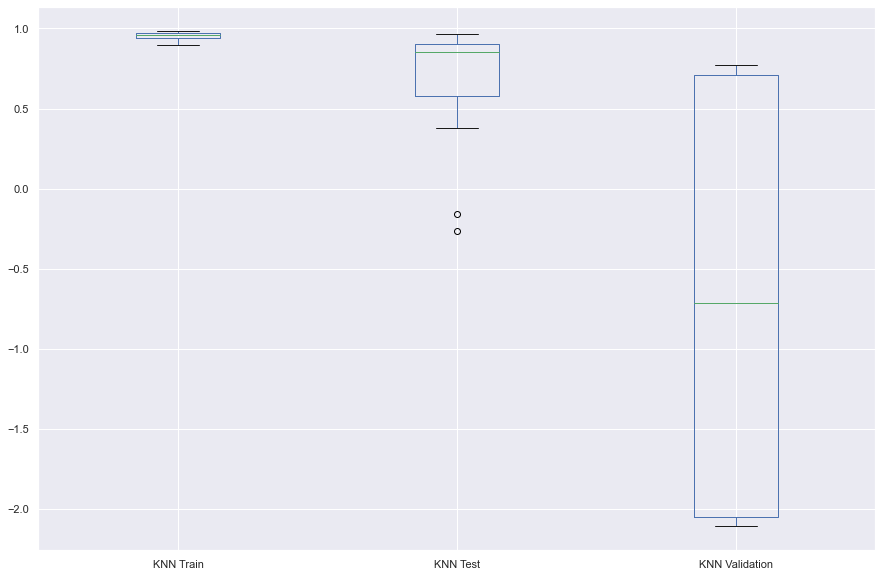

In [115]:
allMods[['KNN Train', 'KNN Test', 'KNN Validation']].plot(kind='box');

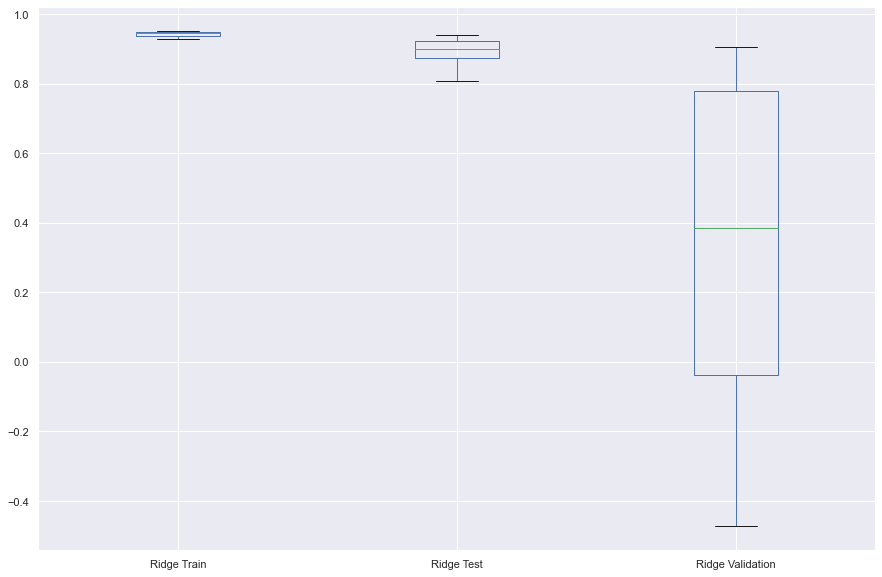

In [116]:
allMods[['Ridge Train', 'Ridge Test', 'Ridge Validation']].plot(kind='box');

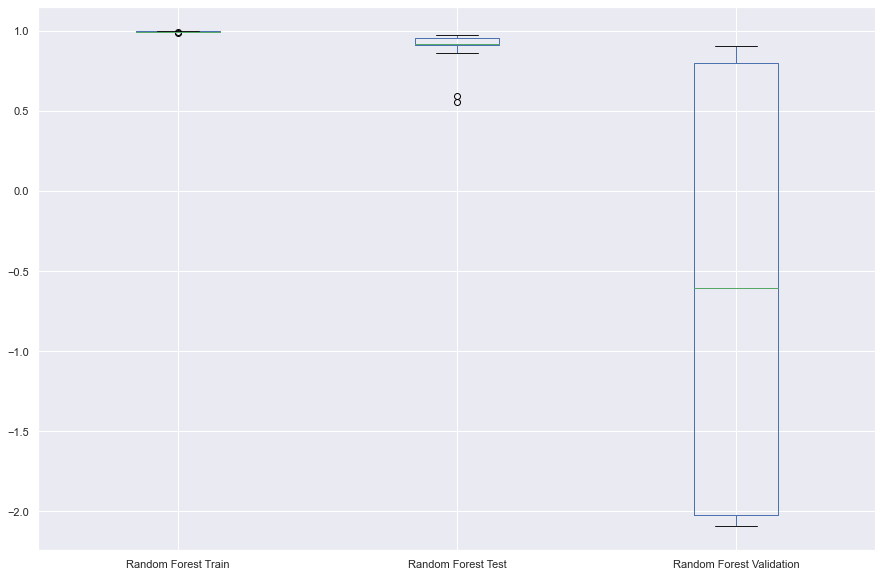

In [117]:
allMods[['Random Forest Train', 'Random Forest Test', 'Random Forest Validation']].plot(kind='box');

## Plot the Models Against Each Other on Validation Results

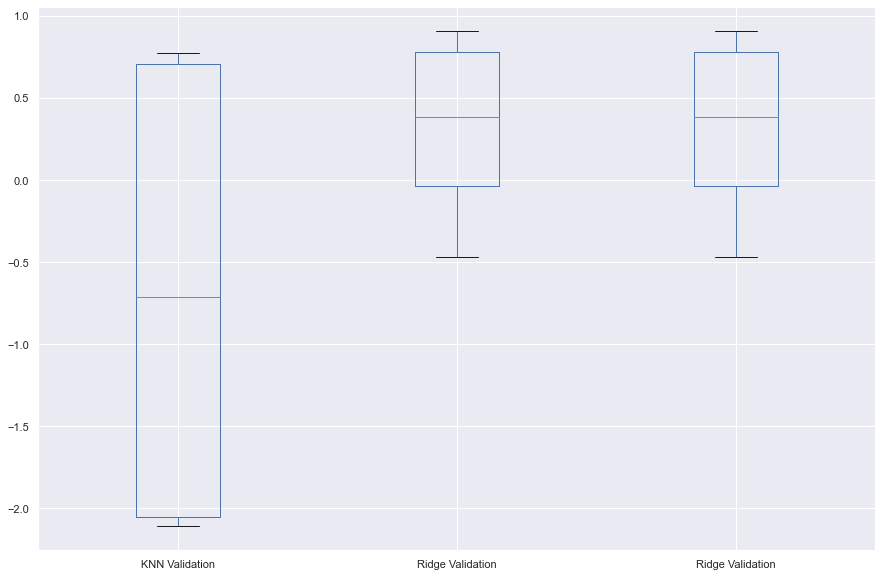

In [118]:
allMods[['KNN Validation', 'Ridge Validation', 'Ridge Validation']].plot(kind='box');

# Best Linear Model Improve with PolyNomial Features

In this section will see if using an Sklearn library Polynomial Features if improvement can be done by helping the model find the best coefficients.

In [119]:
from sklearn.preprocessing import PolynomialFeatures

## Get the Best Ridge Model

In [128]:
# Get the data needed to reconstruct and see if model can be improved
split = allResults[allResults['Data Set'] == 'Validation Data'].sort_values('R2', ascending=False)['Split'].head(1).values[0]
imputer = allResults[allResults['Data Set'] == 'Validation Data'].sort_values('R2', ascending=False)['Imputer'].head(1).values[0]
scaled = allResults[allResults['Data Set'] == 'Validation Data'].sort_values('R2', ascending=False)['Scaled'].head(1).values[0]
outliers = allResults[allResults['Data Set'] == 'Validation Data'].sort_values('R2', ascending=False)['Outliers'].head(1).values[0]
mod = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'Ridge')].sort_values('R2', ascending=False)['Model'].head(1).values[0]

In [129]:
# Filter dataframe based on above parameters
ridge = allResults[(allResults['Data Set'] == 'Test') &
                         (allResults['Imputer'] == imputer) &
                          (allResults['Split'] == split) &
                          (allResults['Scaled'] == scaled) &
                          (allResults['Outliers'] == outliers) &
                          (allResults['Model'] == mod)]

ridge

,Data Set,Label,Scaled,Imputer,Split,MSE,MAE,R2,Model,Best Params,feature importance,Outliers
1,Test,Pedestrian Total,Standard,KNN,0.50,913730.50,745.94,0.92,Ridge,"{'normalize': False, 'alpha': 10}",Not Available,Removed


In [130]:
# Import ast to convert string into a dictionary to select best parameters
# https://favtutor.com/blogs/string-to-dict-python
import ast
# Best parameter values for training
bestParams = ridge[['Best Params']].values[0]
# Convert string to dictionary
bestParams = ast.literal_eval(bestParams[0])

## Data Preperation For Ridge Model

In [131]:
# Prepare the dataset for processing
if outliers == 'Not Removed':
    validationData = valData
elif outliers == 'Removed': 
    validationData = valData2
x = dataPrep(validationData, split, scaled, 'Pedestrian Total')
x.imputeData(imputer)
x.scaleData()
X_data = x.XData

## Transform Dataset Using Polynomial Features

In [132]:
poly_transformer = PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
X_dataPoly = poly_transformer.fit_transform(x.XData)

## Fit the Models With best Parameters 

In [134]:
if mod == 'Ridge':
    rg1 = Ridge(normalize=bestParams['normalize'], alpha=bestParams['alpha'])
    rg1.fit(X_data, x.yData)
    rg2 = Ridge(normalize=bestParams['normalize'], alpha=bestParams['alpha'])
    rg2.fit(X_dataPoly, x.yData)

## Compare Scores and Plot

In [135]:
y_pred = rg1.predict(X_data)
print("Mean Square Error {} ".format(mean_squared_error(x.yData, y_pred)))
print("Mean Absolute Error {} ".format(mean_absolute_error(x.yData, y_pred)))
print("Mean Absolute Error {} ".format(r2_score(x.yData, y_pred)))

Mean Square Error 1170987.8756998035 
Mean Absolute Error 789.0269374407277 
Mean Absolute Error 0.9328982147464702 


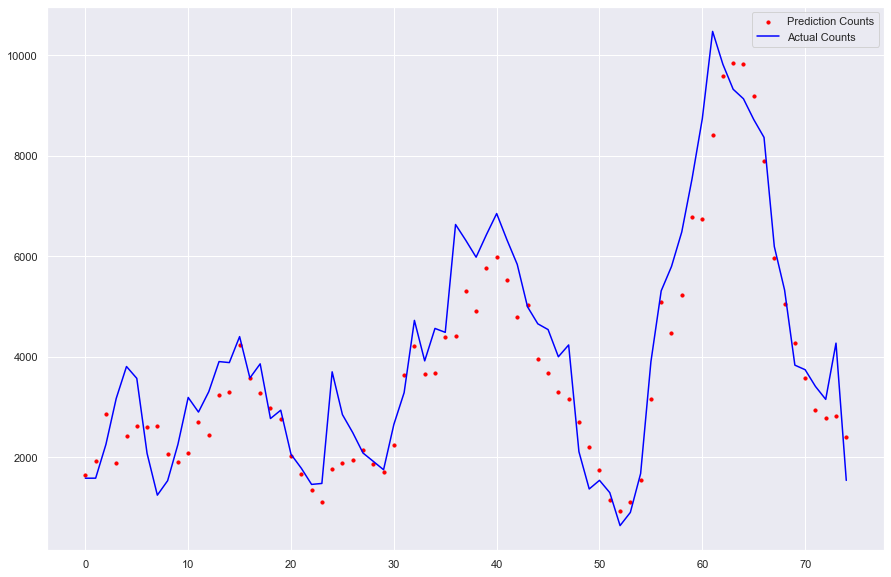

In [136]:
period = 75
x_ax = range(len(x.yData[:period]))
plt.scatter(x_ax, y_pred[:period], s=10, color="red", label="Prediction Counts")
plt.plot(x_ax, x.yData[:period], lw=1.5, color="blue", label="Actual Counts")
plt.legend()
plt.show()

In [137]:
y_pred = rg2.predict(X_dataPoly)
print("Mean Square Error {} ".format(mean_squared_error(x.yData, y_pred)))
print("Mean Absolute Error {} ".format(mean_absolute_error(x.yData, y_pred)))
print("Mean Absolute Error {} ".format(r2_score(x.yData, y_pred)))

Mean Square Error 738338.7055853291 
Mean Absolute Error 598.1444759014761 
Mean Absolute Error 0.9576905565850136 


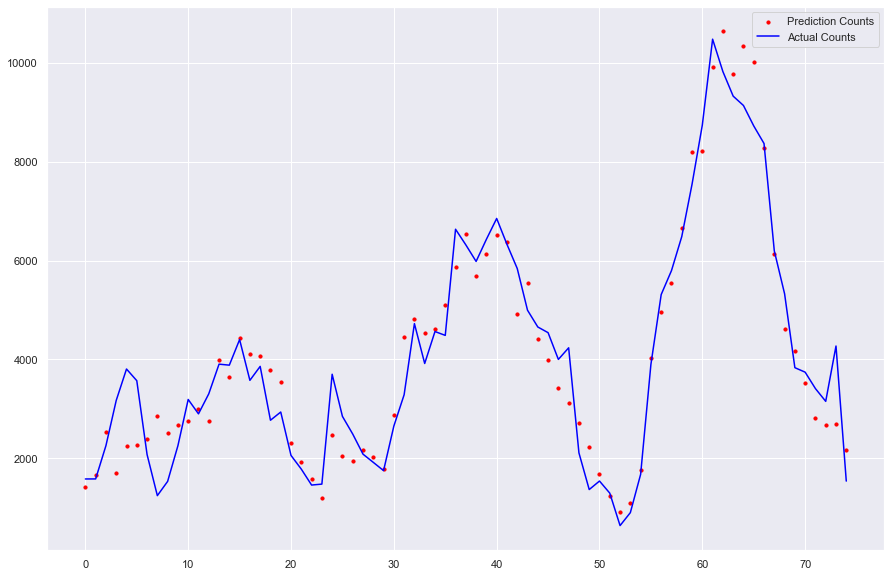

In [138]:
period = 75
x_ax = range(len(x.yData[:period]))
plt.scatter(x_ax, y_pred[:period], s=10, color="red", label="Prediction Counts")
plt.plot(x_ax, x.yData[:period], lw=1.5, color="blue", label="Actual Counts")
plt.legend()
plt.show()

## Plot Coeffiecents of Features

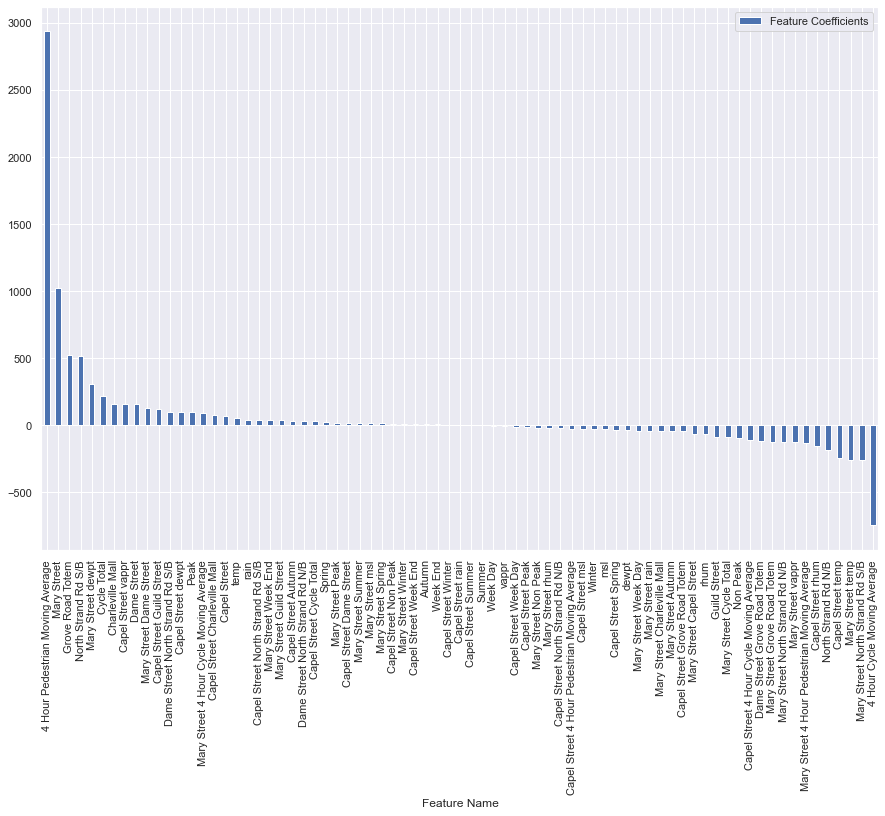

In [166]:
features = x.data.columns

topFeatures = 75
features_poly = poly_transformer.get_feature_names(features)
features_nonzero = np.array(features_poly)[rg2.coef_ != 0][:topFeatures]
coef_nonzero = rg2.coef_[rg2.coef_ != 0][:topFeatures]

feat = pd.DataFrame()
feat['Feature Name'] = features_nonzero
feat['Feature Coefficients'] = coef_nonzero
feat.sort_values('Feature Coefficients', inplace=True, ascending=False)
feat.reset_index(drop=True, inplace=True)
feat.set_index('Feature Name', inplace=True)
feat.plot(kind='bar');

In [167]:
feat

,Feature Coefficients
Feature Name,
4 Hour Pedestrian Moving Average,2936.23
Mary Street,1024.65
Grove Road Totem,526.46
North Strand Rd S/B,518.84
Mary Street dewpt,306.58
Cycle Total,220.45
Charleville Mall,159.68
Capel Street vappr,158.59
Dame Street,156.29


# Get the Best Random Forest

In this final section will recreate the best Random Forest and see if how much difference is there in feature importance from the test dataset to the validation dataset. 

In [144]:
# Get the data needed to reconstruct and see if model can be improved
split = allResults[(allResults['Data Set'] == 'Validation Data') & (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Split'].head(1).values[0]
imputer = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Imputer'].head(1).values[0]
scaled = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Scaled'].head(1).values[0]
outliers = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Outliers'].head(1).values[0]
modd = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Model'].head(1).values[0]

In [145]:
# Filter dataframe based on above parameters
randomForest = allResults[(allResults['Data Set'] == 'Test') &
                         (allResults['Imputer'] == imputer) &
                          (allResults['Split'] == split) &
                          (allResults['Scaled'] == scaled) &
                          (allResults['Outliers'] == outliers) &
                          (allResults['Model'] == modd)]

randomForest

,Data Set,Label,Scaled,Imputer,Split,MSE,MAE,R2,Model,Best Params,feature importance,Outliers
1,Test,Pedestrian Total,Standard,Pandas,0.10,923752.36,694.73,0.92,RandomForest,"{'n_estimators': 500, 'max_features': 'auto', ...","[0.043642223699807456, 0.008655013766143827, 0...",Removed


In [146]:
# Get best params as data above will be overwritten later to get the above best parameters
bestParams = randomForest[['Best Params']].values[0]
bestParams

array(["{'n_estimators': 500, 'max_features': 'auto', 'max_depth': 20, 'bootstrap': True}"],
      dtype=object)

## Plot the Feature Importance From Model

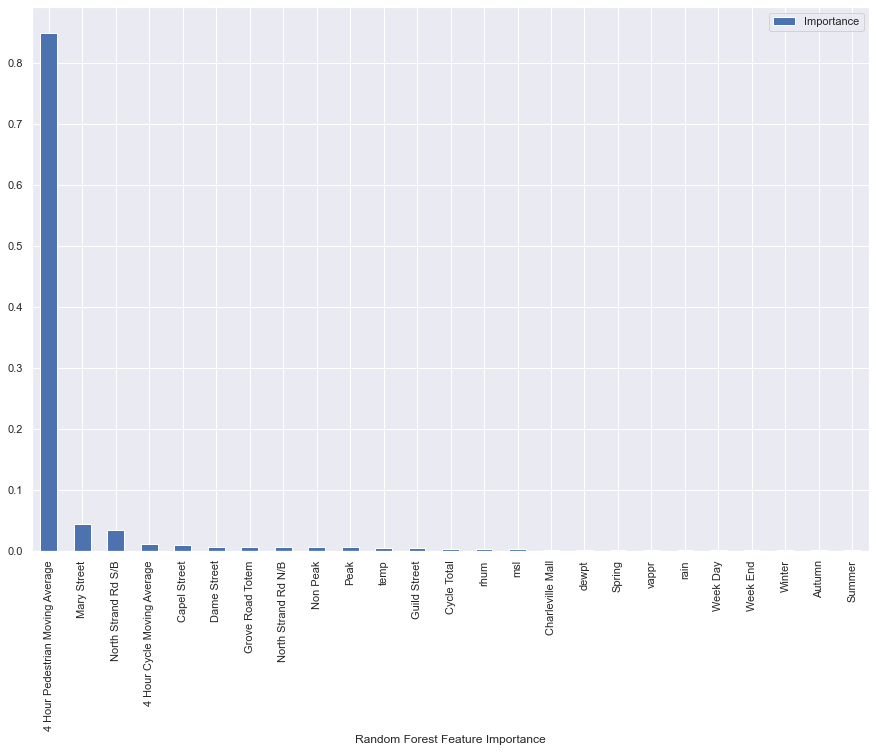

In [147]:
#https://gist.github.com/seanbehan/6e5f86d253776f1d68da
randFeats = randomForest[['feature importance']].values[0]
flattened = [val for sublist in randFeats for val in sublist]

rfFeats = pd.DataFrame()
rfFeats['Features'] = x.data.columns
rfFeats.set_index('Features', inplace=True)
rfFeats['Importance']= flattened
rfFeats.sort_values(by= 'Importance', inplace=True, ascending=False)

rfFeats.plot(kind='bar')
plt.xlabel("Random Forest Feature Importance");

## Recreate Best Model To Compare Feature Importance

In [148]:
# Get the data needed to reconstruct and see if model can be improved
split = allResults[(allResults['Data Set'] == 'Validation Data') & (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Split'].head(1).values[0]
imputer = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Imputer'].head(1).values[0]
scaled = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Scaled'].head(1).values[0]
outliers = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Outliers'].head(1).values[0]
modd = allResults[(allResults['Data Set'] == 'Validation Data')& (allResults['Model'] == 'RandomForest')].sort_values('R2', ascending=False)['Model'].head(1).values[0]

In [149]:
# Filter dataframe based on above parameters
randomForest = allResults[(allResults['Data Set'] == 'Validation Data') &
                         (allResults['Imputer'] == imputer) &
                          (allResults['Split'] == split) &
                          (allResults['Scaled'] == scaled) &
                          (allResults['Outliers'] == outliers) &
                          (allResults['Model'] == modd)]

randomForest

,Data Set,Label,Scaled,Imputer,Split,MSE,MAE,R2,Model,Best Params,feature importance,Outliers
2,Validation Data,Pedestrian Total,Standard,Pandas,0.10,1685701.90,972.64,0.90,RandomForest,NA,NA,Removed


## Data Preperation for Random Forest

In [150]:
if outliers == 'Not Removed':
    validationData = valData
elif outliers == 'Removed': 
    validationData = valData2
x = dataPrep(validationData, split, scaled, 'Pedestrian Total')
x.imputeData(imputer)
x.scaleData()
X_data = x.XData

## Fit the Model and Plot

In [151]:
# Best parameters for the model from Test
bestParams = ast.literal_eval(bestParams[0])

rf = RandomForestRegressor(n_estimators=bestParams['n_estimators'], 
                           max_features=bestParams['max_features']
                           ,max_depth=bestParams['max_depth'], 
                           bootstrap=bestParams['bootstrap']
                           , n_jobs=-1)
rf.fit(X_data, x.yData)

RandomForestRegressor(max_depth=20, n_estimators=500, n_jobs=-1)

In [152]:
y_pred = rf.predict(X_data)
print("Mean Square Error {} ".format(mean_squared_error(x.yData, y_pred)))
print("Mean Absolute Error {} ".format(mean_absolute_error(x.yData, y_pred)))
print("Mean Absolute Error {} ".format(r2_score(x.yData, y_pred)))

Mean Square Error 99483.9262312198 
Mean Absolute Error 219.14167946208138 
Mean Absolute Error 0.9942992159076319 


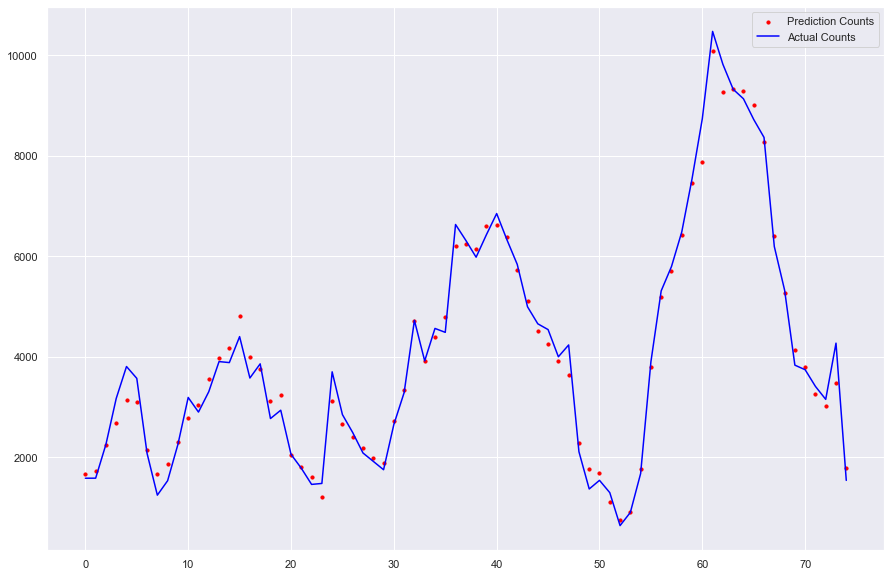

In [153]:
period = 75
x_ax = range(len(x.yData[:period]))
plt.scatter(x_ax, y_pred[:period], s=10, color="red", label="Prediction Counts")
plt.plot(x_ax, x.yData[:period], lw=1.5, color="blue", label="Actual Counts")
plt.legend()
plt.show()

## Plot the Feature Importance From Model

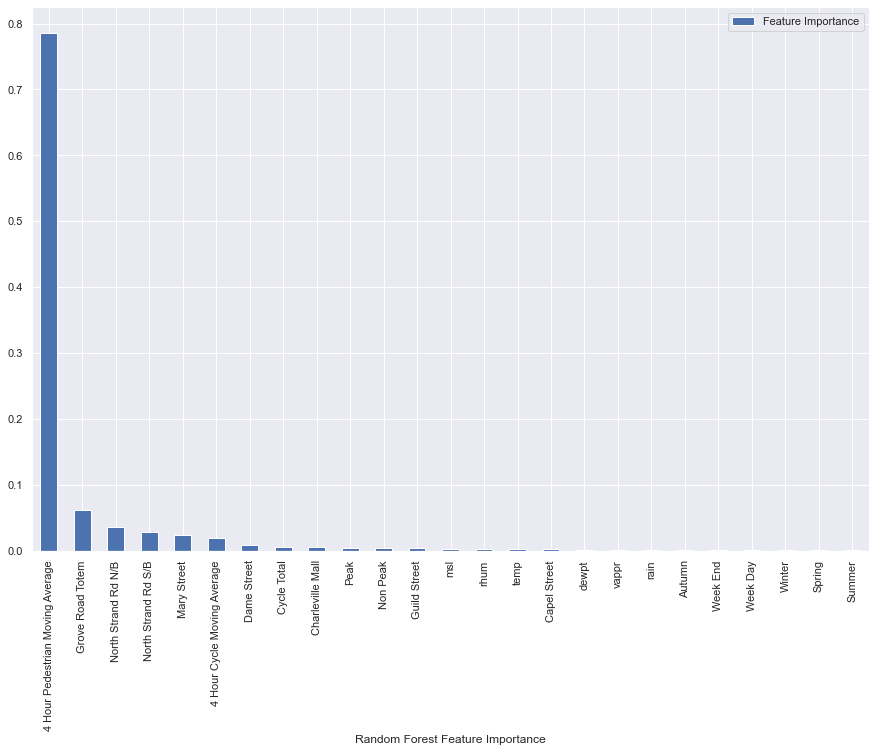

In [154]:
rfFeats = pd.DataFrame()
rfFeats['Features'] = x.data.columns
rfFeats.set_index('Features', inplace=True)
rfFeats['Importance']= rf.feature_importances_
rfFeats.sort_values(by= 'Importance', inplace=True, ascending=False)

rfFeats.plot(kind='bar')
plt.legend(labels=['Feature Importance'])
plt.xlabel("Random Forest Feature Importance");